In [1]:
import os.path
import numpy as np
import matplotlib.pyplot as plt
from copy import deepcopy

import seaborn as sns
path = os.getcwd()
print(path)
pth = '../Data/'
img_pth = '../Outputs/'
%load_ext autoreload
%autoreload 2
import matplotlib as mpl
#%matplotlib widget
import glob 
import ana_xrr
colors = ['#4053d3', '#b51d14', '#ddb310','#348f42','#7e1e9c', '#75bbfd', '#cacaca']
sns.set_palette(colors)
from joblib import Parallel, delayed
from tqdm import tqdm

def grab_ind(obj_list, ind): 
    return [o[ind] for o in obj_list]

c:\_Lib\xrr_analysis


# Initialize

# Conversions

 $ q = 4 \pi \sin \theta / \lambda$

 The oscillations go as $ \cos (4 \pi d / \sqrt{\sin^2 \theta - 2 \delta})$ where $d$ is the layer thickness, so 

 $ \sin \theta = q \lambda/ 4 \pi$

 $ \cos (4 \pi d / \lambda \sqrt{(q \lambda / 4 \pi)^2 - 2 \delta})$

## Load data

In [277]:
flist_lv = glob.glob('lv*.txt', root_dir=pth)
flist_lv.sort()
print(flist_lv)

labs_lv = ['67 nm Al', '30 nm Al/AlOx/37 nm Al', 'Slow 50 nm Al/5x AlOx/20 nm Al', 'Fast 50 nm Al/5x AlOx/20 nm Al','80 nm Ta/8 nm Al/AlOx/50 nm Al','80 nm Ta/8 nm Al/AlOx/50 nm Al','80 nm Ta/8 nm Al/AlOx/50 nm Al redo','80 nm Ta/AlOx/150 nm Ta']
flist_stan = glob.glob('su*.txt', root_dir=pth)
flist_stan.sort()
print(flist_stan)
labs_stan = ['80 Nb/8 Al/AlOx/50 Al 9 T Static','80 Nb/8 Al/AlOx/50 Al 9 T Static Redo','80 Nb/8 Al/AlOx/3 Al/80 nm Nb 9 T Static','80 Nb/8 Al/AlOx/50 Al 1 T Static','80 Nb/8 Al/AlOx/50 Al 6 T Dynamic','80 Nb/8 Al', '80 Nb/8 Al, a-plane', '80 Nb/8 Al extra clean', '80 Nb/8 Al unanneal']

flist = flist_lv + flist_stan
labs = labs_lv + labs_stan

['lv1_XRR_1_scan1.txt', 'lv2_XRR_1_scan1.txt', 'lv3_XRR_1_scan1.txt', 'lv4_XRR_1_scan1.txt', 'lv5_XRR_1_scan1.txt', 'lv6_XRR_1_redo_scan1.txt', 'lv6_XRR_1_scan1.txt', 'lv7_XRR_1_scan1.txt']
['su01_XRR_1_remeas_scan1.txt', 'su01_XRR_3_scan1.txt', 'su02_XRR_1_scan1.txt', 'su03_XRR_1_scan1.txt', 'su04_XRR_1_scan1.txt', 'su05_XRR_1_scan1.txt', 'su06_XRR_1_scan1.txt', 'su07_XRR_1_scan1.txt', 'su08_XRR_1_scan1.txt']


# Al devices

## Compare fit ranges

1.3498101268122702: : 254it [00:43,  5.84it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/Users/sph/Library/CloudStorage/OneDrive-SharedLibraries-LLNL/MQC - JJ - Stanford - General/XRay/XRR/Code/ana_xrr.py:371: UserWarning: The figure layout has changed to tight
  


Layer Properties:
  Layer  Thickness (Å)  Roughness (Å)  SLD (10^-6 cm^-2)
 alox_0       8.030519       1.442659          25.095775
   al_1     476.407441       0.055019          18.069068
 buff_2      15.172346       9.235887           9.353336
al2o3_3            inf      12.986813          33.319000

Additional Parameters:
       Parameter              Value
           Chisq 2.6994001168954296
Log10 Background               -9.0
 DQ - Resolution           1.983825
        Q Offset          -0.001667
           Scale           0.882829


0.486464272821926: : 338it [00:46,  7.35it/s]  
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/Users/sph/Library/CloudStorage/OneDrive-SharedLibraries-LLNL/MQC - JJ - Stanford - General/XRay/XRR/Code/ana_xrr.py:371: UserWarning: The figure layout has changed to tight
  


0.27021613094637137: : 259it [00:32,  8.06it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Layer Properties:
  Layer  Thickness (Å)  Roughness (Å)  SLD (10^-6 cm^-2)
 alox_0      41.150303       4.385400          17.723192
   al_1     432.017161       7.789529          21.245499
 buff_2      27.267291       8.980293          17.021732
al2o3_3            inf      12.303766          33.319000

Additional Parameters:
       Parameter              Value
           Chisq 0.5403473522469167
Log10 Background           -6.30103
 DQ - Resolution           2.310039
        Q Offset           0.000031
           Scale           1.492158


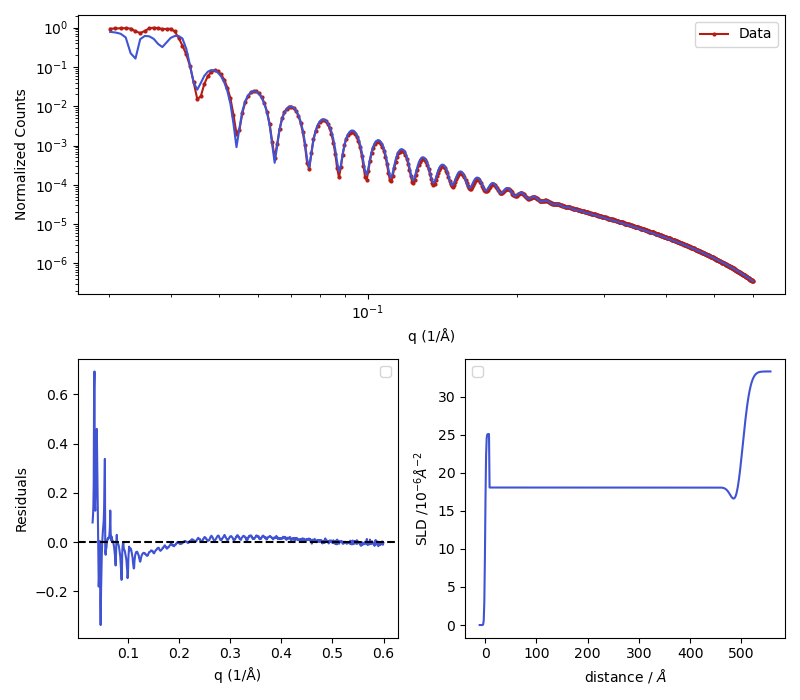

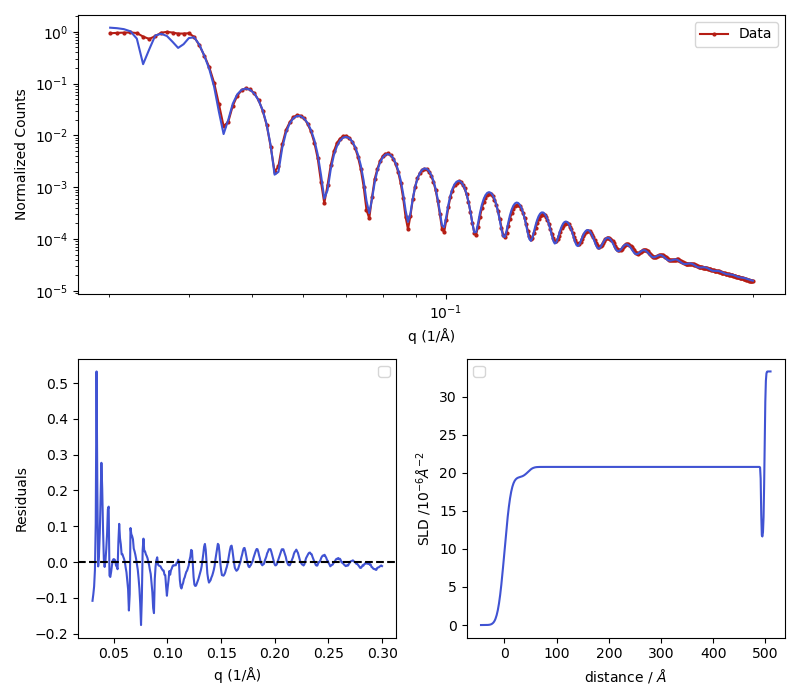

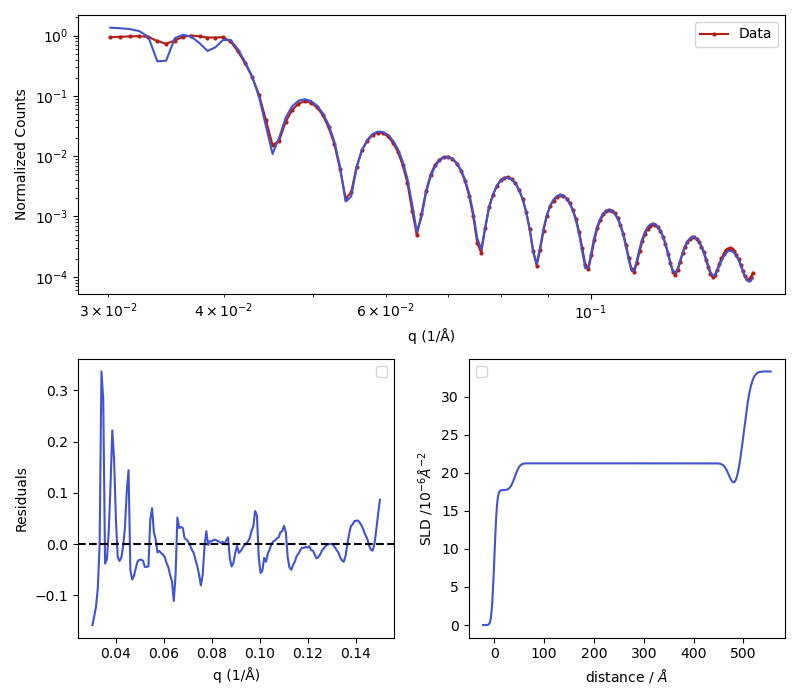

In [24]:
#par={'scale':1, 'bkg':5e-9, 'q_offset':0, 'dq - resolution':0.5, 'sub_rough_max':20, 'thk':[5, 450, 5, np.inf]}
outs =[]
outs.append(ana_xrr.sim(pth + flist[0], 'alox/al/buff/al2o3', par, [0.03, 0.6], img_path=img_pth))
ana_xrr.generate_table(outs[-1][1]) 

outs.append(ana_xrr.sim(pth + flist[0], 'alox/al/buff/al2o3', outs[-1][1], [0.03, 0.3], img_path=img_pth))

outs.append(ana_xrr.sim(pth + flist[0], 'alox/al/buff/al2o3', outs[-1][1], [0.03, 0.15], img_path=img_pth))
ana_xrr.generate_table(outs[-1][1])

## Compare model levels

1.4431727024700678: : 52it [00:27,  1.92it/s]
c:\_Lib\xrr_analysis\ana_xrr.py:712: UserWarning: The figure layout has changed to tight
  fig.tight_layout()


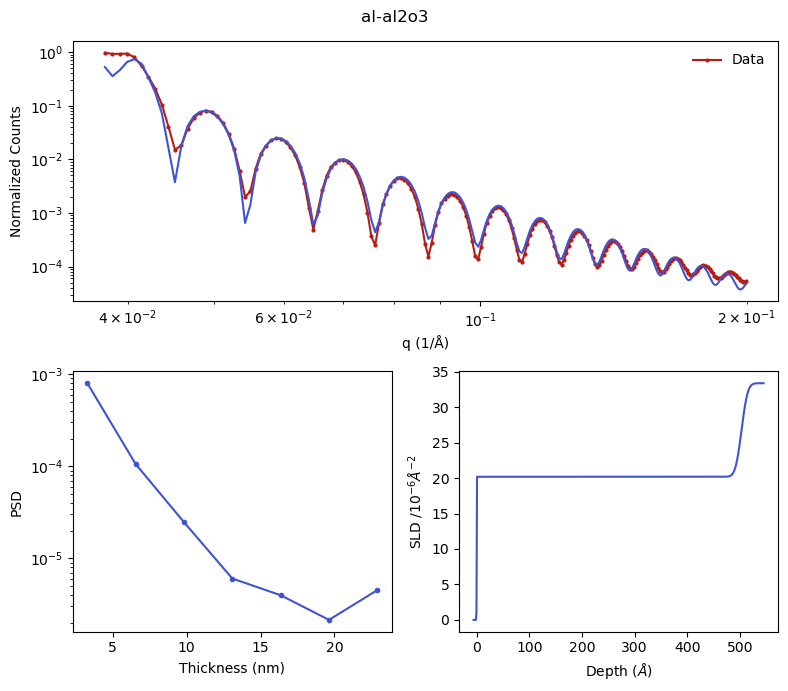

1.3923190264436123: : 78it [00:58,  1.33it/s]


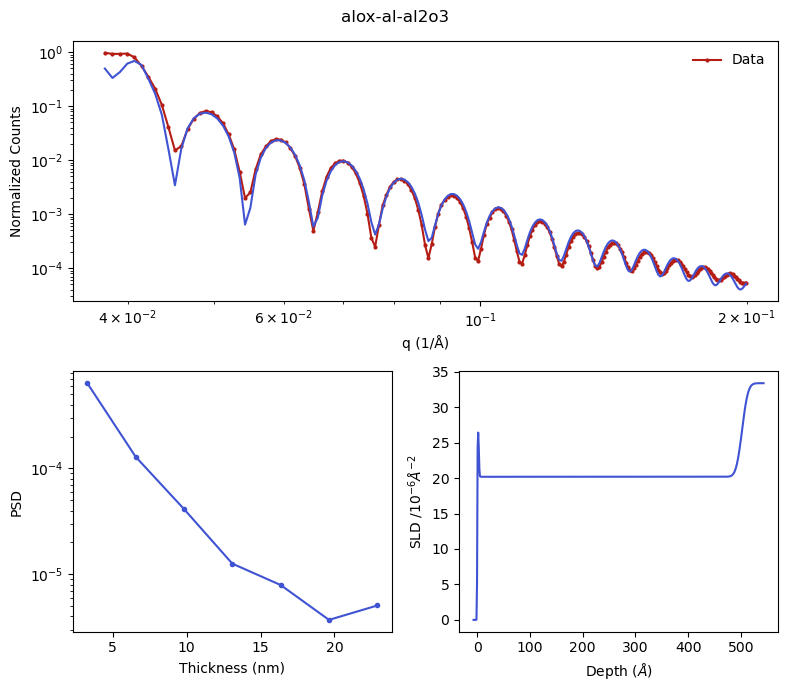

0.859505296634449: : 194it [03:08,  1.03it/s] 


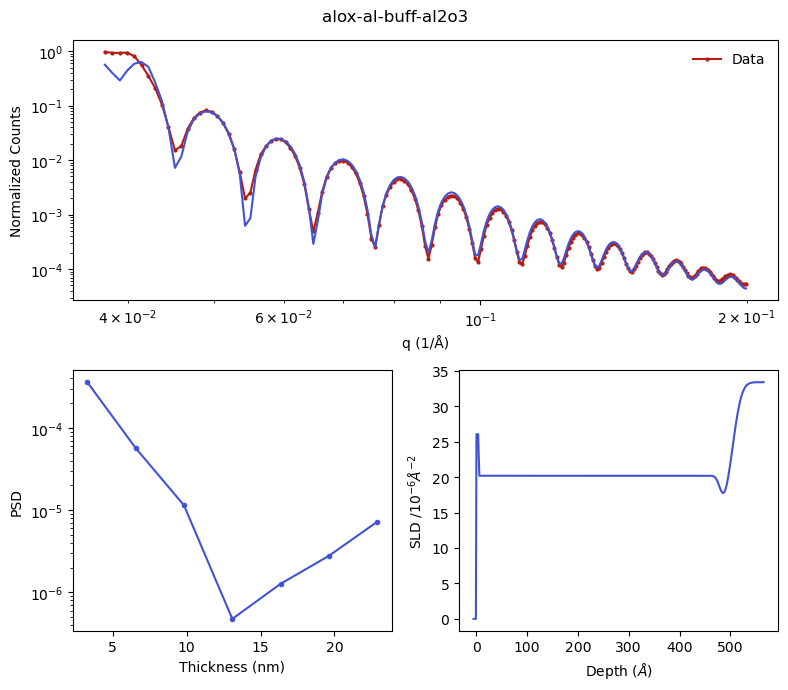

0.8488212143089883: : 160it [02:33,  1.04it/s]


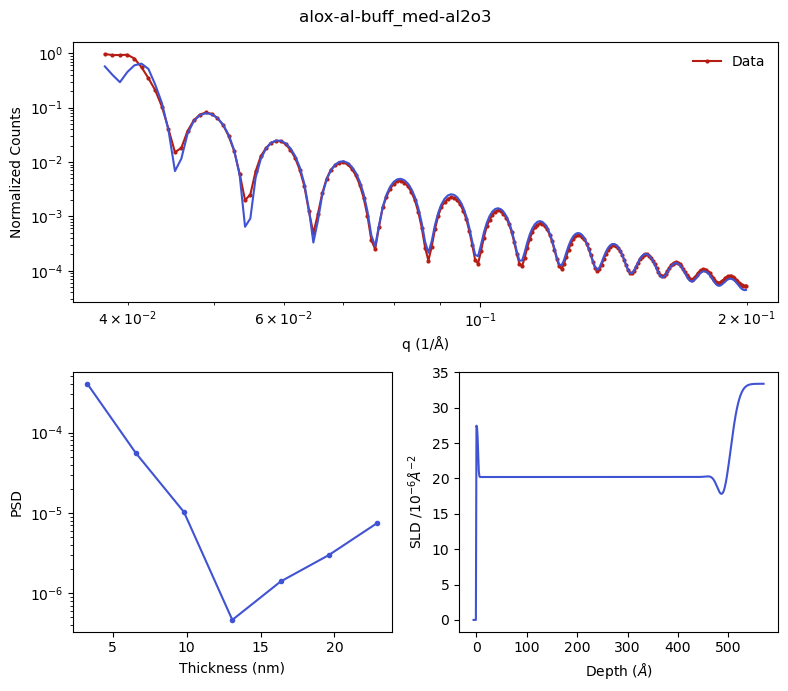

2.6191184698600147: : 50it [00:27,  1.85it/s]


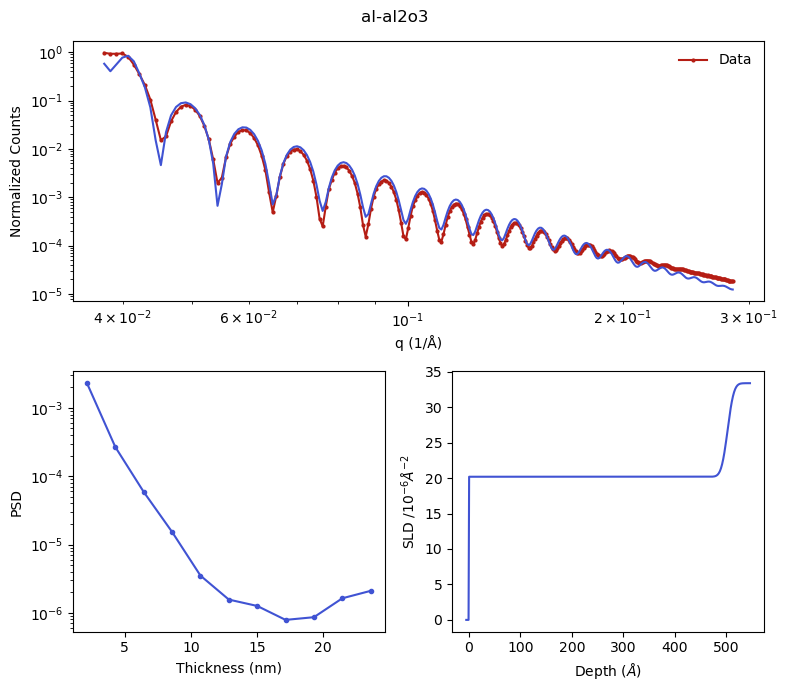

1.5690895046490443: : 91it [01:12,  1.26it/s]


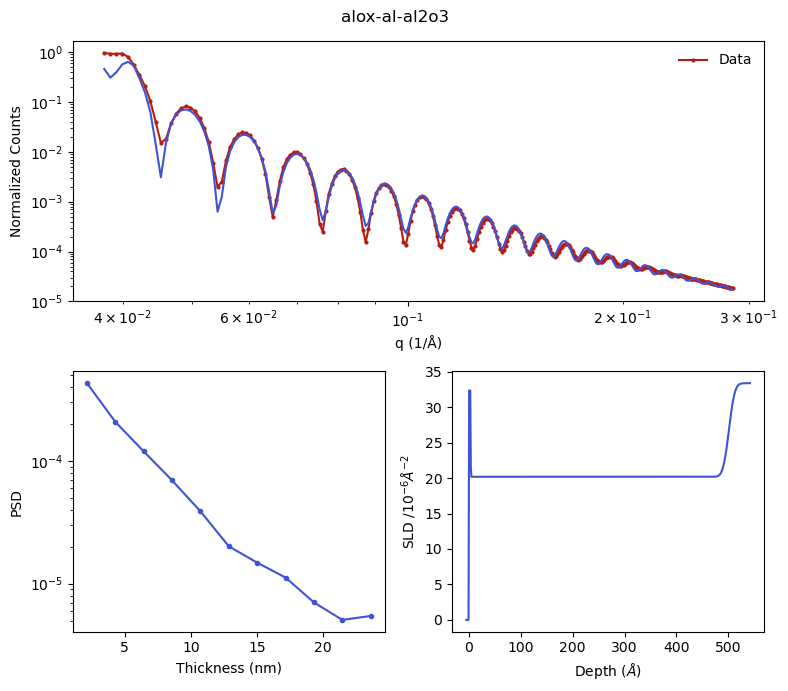

0.933087127360107: : 222it [03:41,  1.00it/s] 


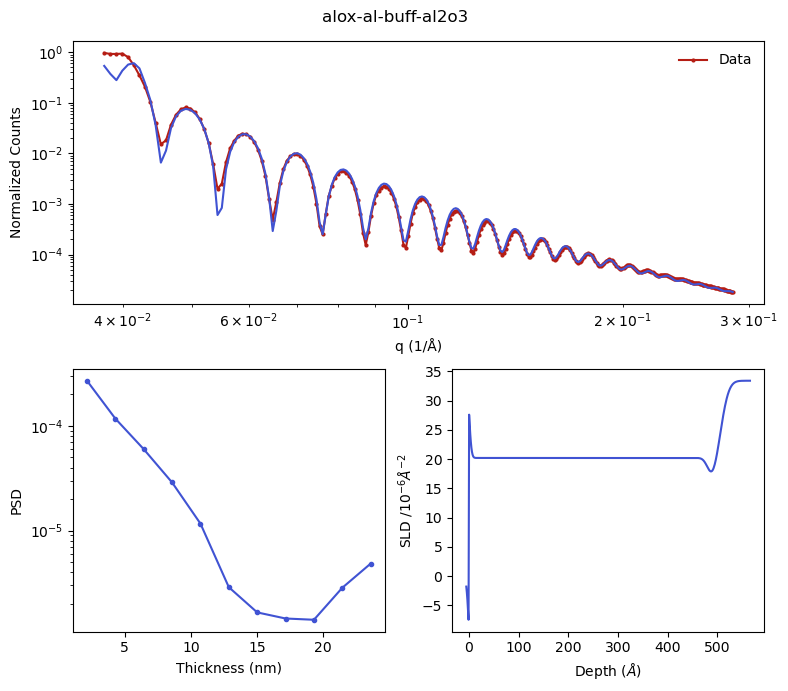

1.3278548283819576: : 187it [03:04,  1.01it/s]


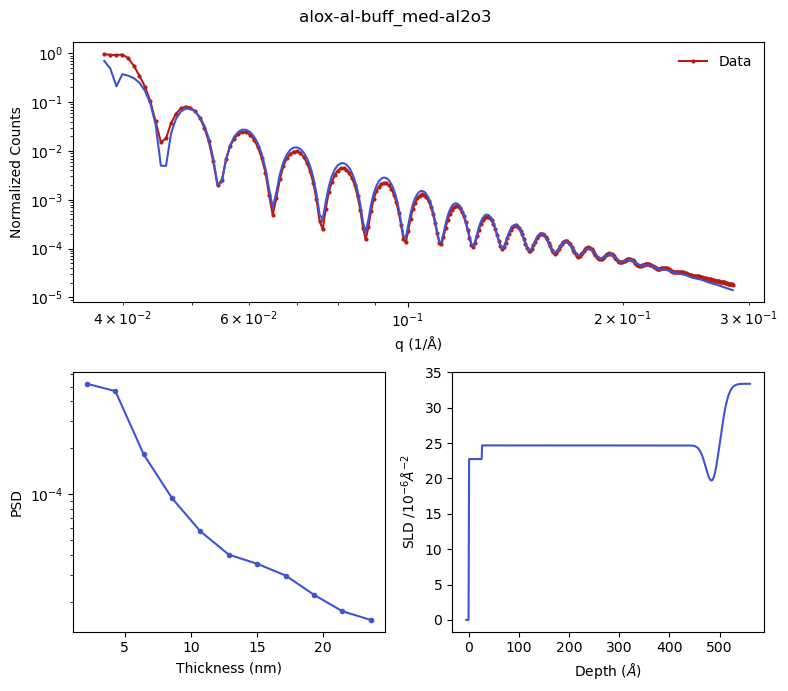

4.241304467356354: : 61it [00:34,  1.78it/s]


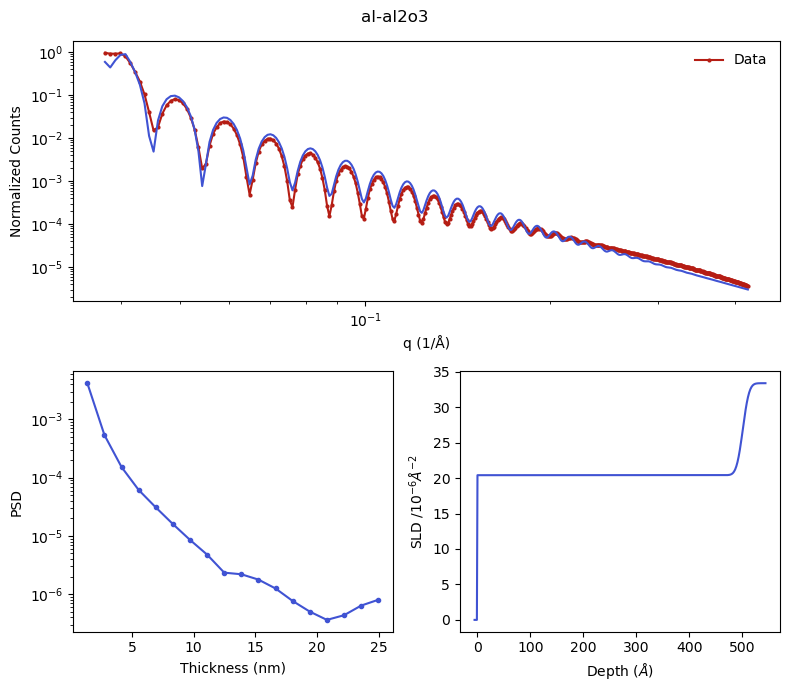

1.6846560947689668: : 144it [01:55,  1.24it/s]


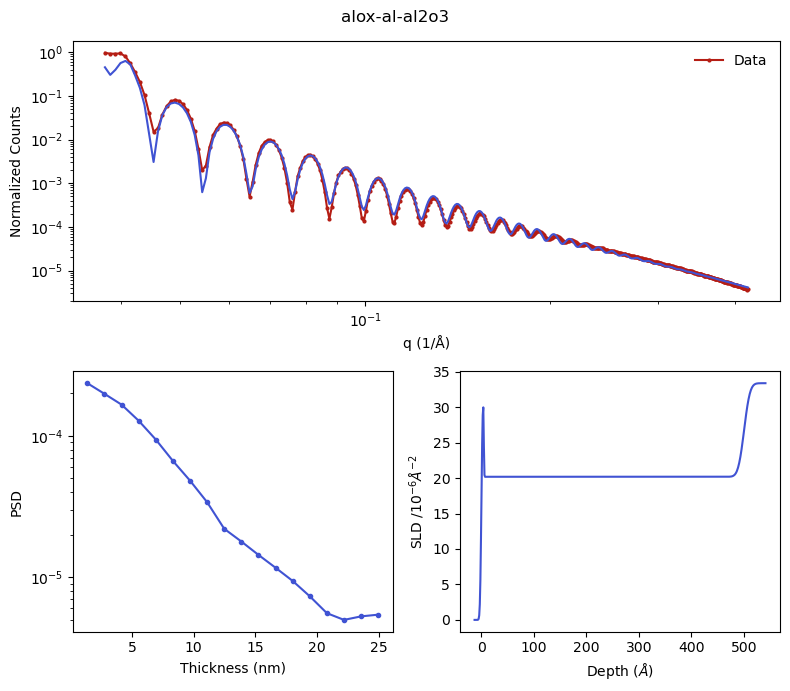

1.0366087125117933: : 221it [03:59,  1.08s/it]


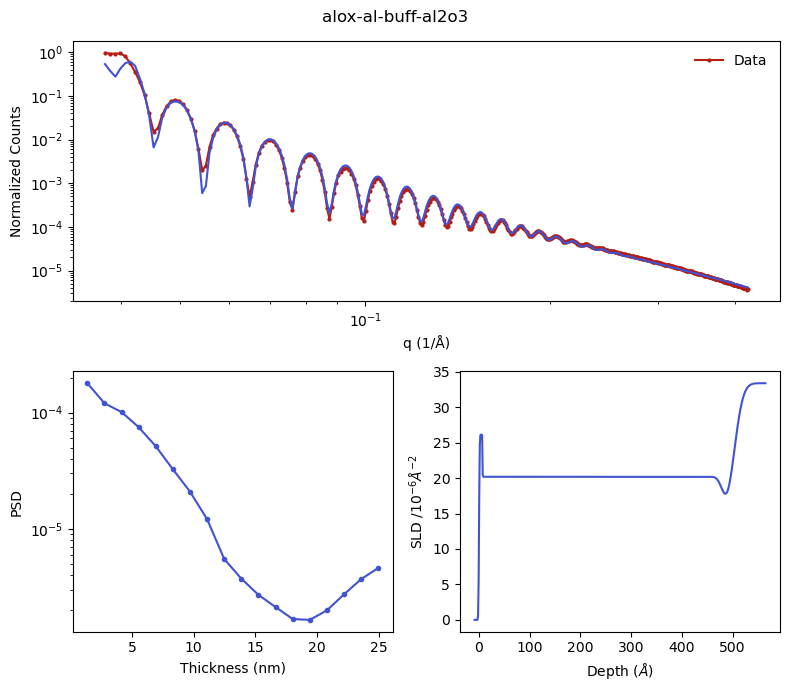

1.7790710691475322: : 200it [03:35,  1.08s/it]


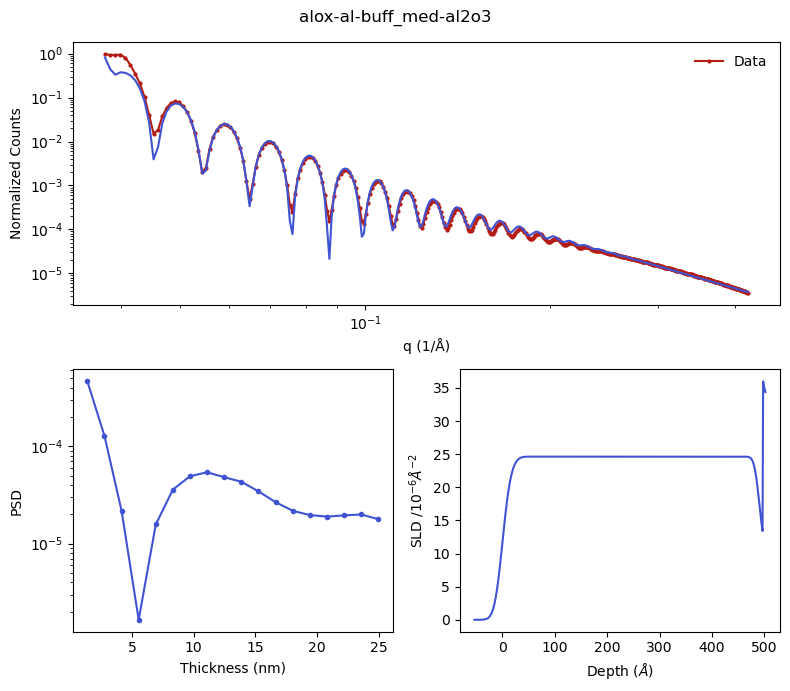

6.469547250326745: : 42it [00:24,  1.71it/s]


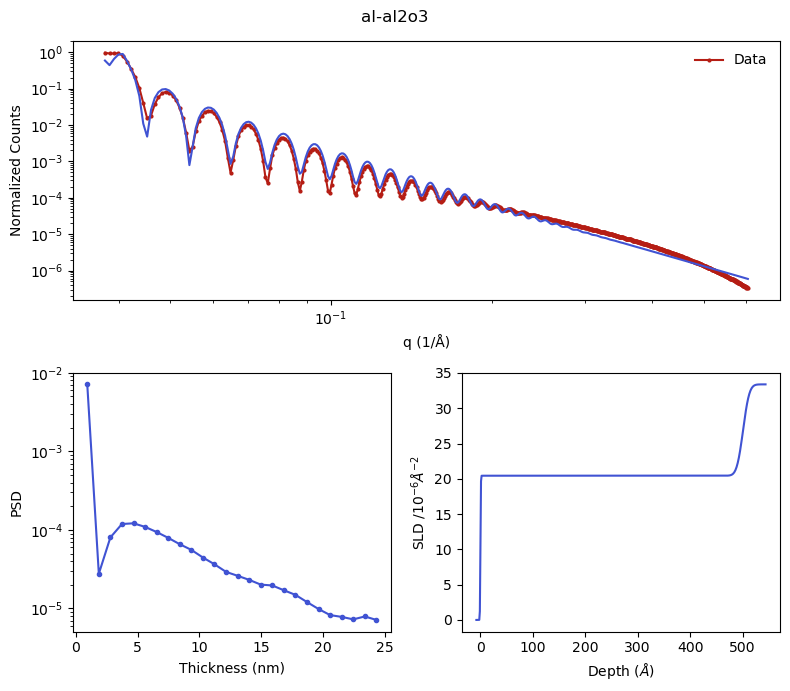

2.258211770471923: : 125it [01:43,  1.21it/s] 


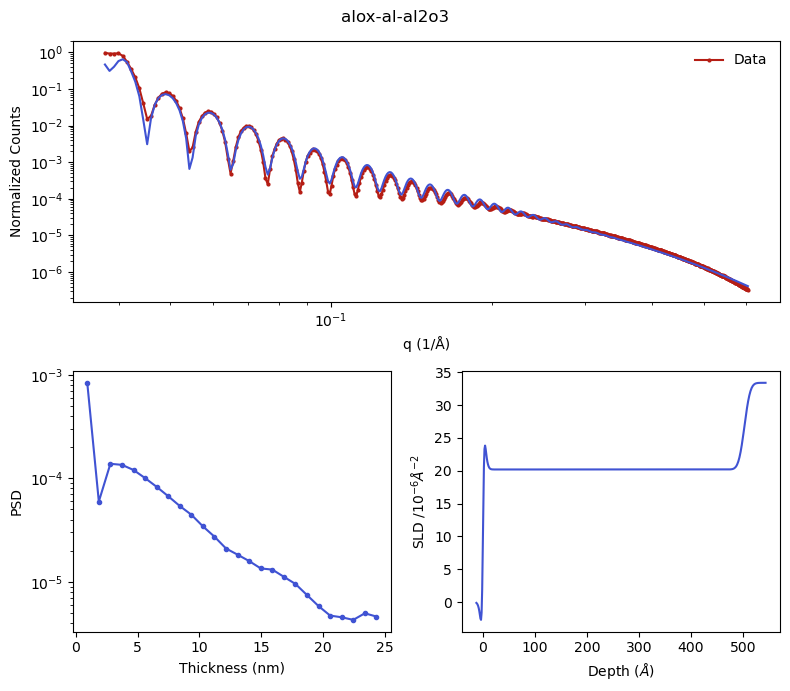

1.157284262801851: : 331it [06:00,  1.09s/it] 


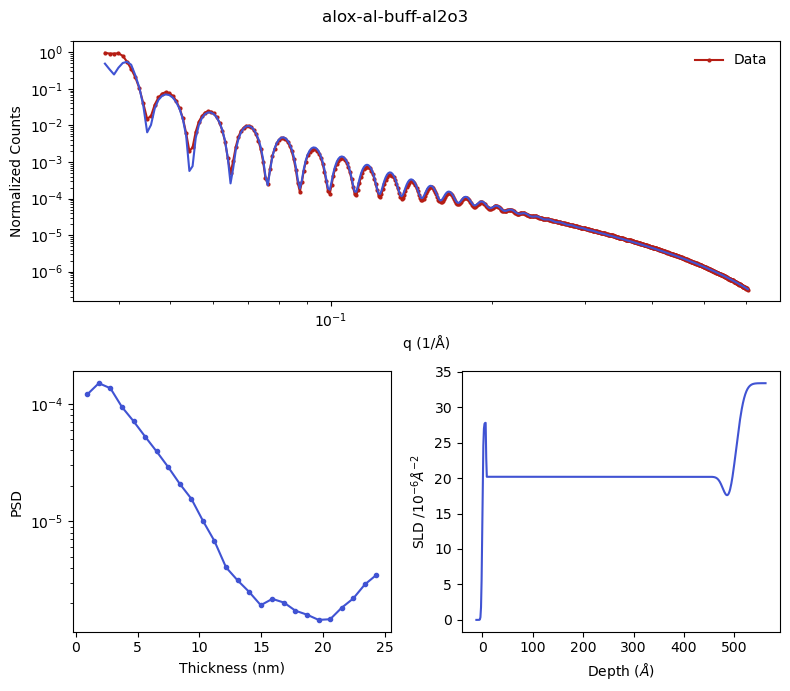

0.9512161437892978: : 324it [06:00,  1.11s/it]


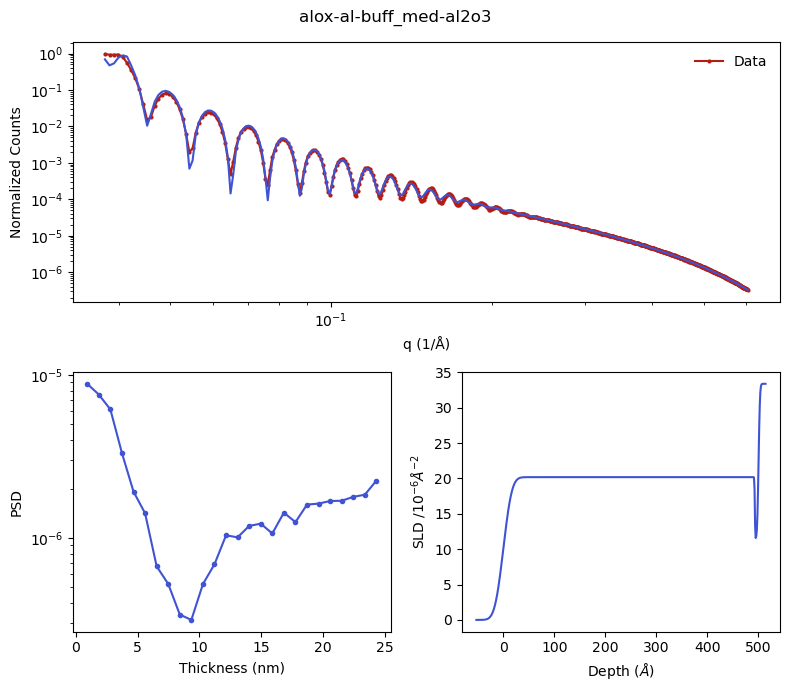

In [4]:
par={'scale':1, 'bkg':5e-9, 'q_offset':0, 'dq - resolution':0.5, 'sub_rough_max':23}
qrng = [0.037, 0.15]
        
layers = ['al', 'alox/al', 'alox/al/buff', 'alox/al/buff_med']
for i in range(len(layers)): 
    layers[i]=layers[i]+ '/al2o3'

out_lists = [[] for _ in range(len(layers))]
SLD_rng = [0.3, 0.1]
data_file = flist[0]

for i in range(4): 
    qrng[1]=0.2 + 0.06*i+0.025*i**2
    for j in range(len(layers)):
        par = {'scale':1, 'bkg':5e-9, 'q_offset':0, 'dq - resolution':0.5, 'sub_rough_max':20, 'x_err':1.9}
        par['thk']=[490]
        out_lists[j].append(ana_xrr.sim(pth + data_file, layers[j], par, qrng, SLD_rng=SLD_rng))

full_obj = ana_xrr.collect_obj(out_lists)
full_pars = ana_xrr.collect_pars(out_lists)

6


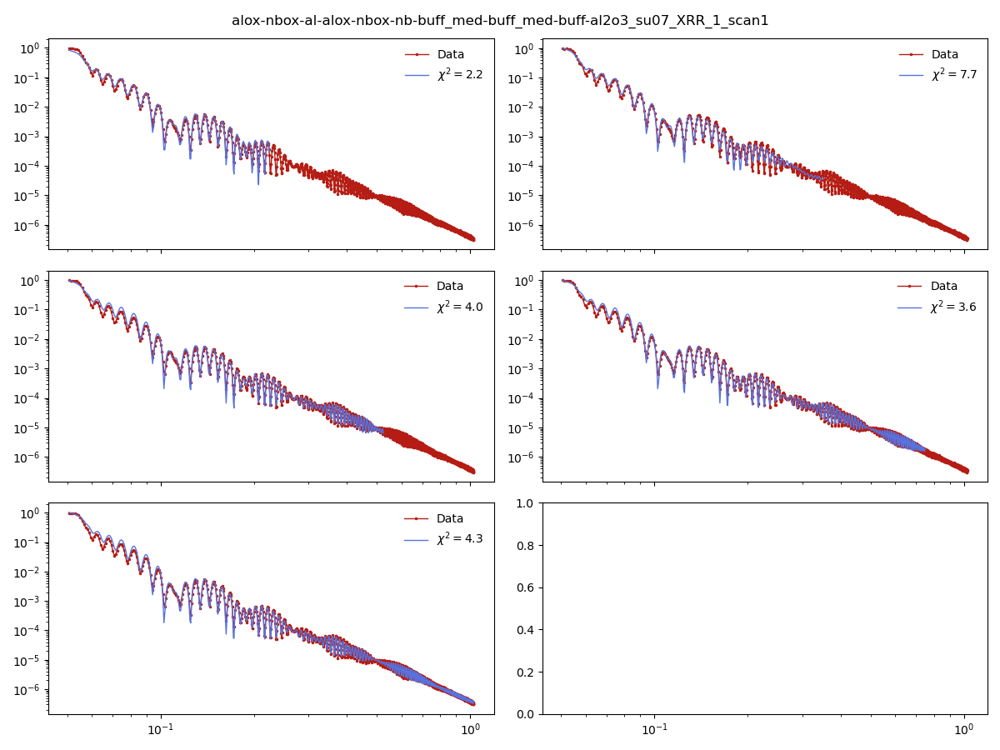

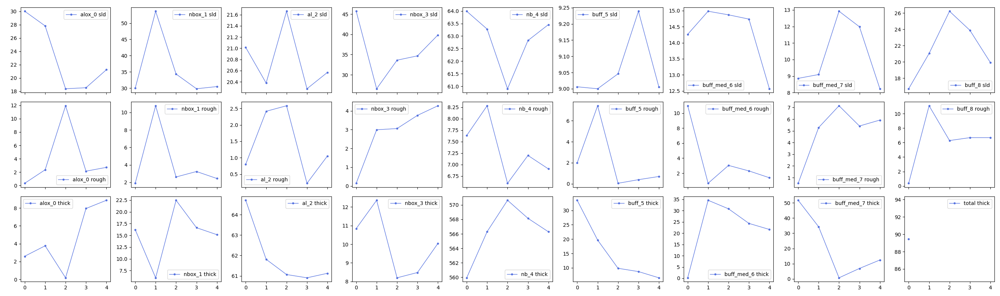

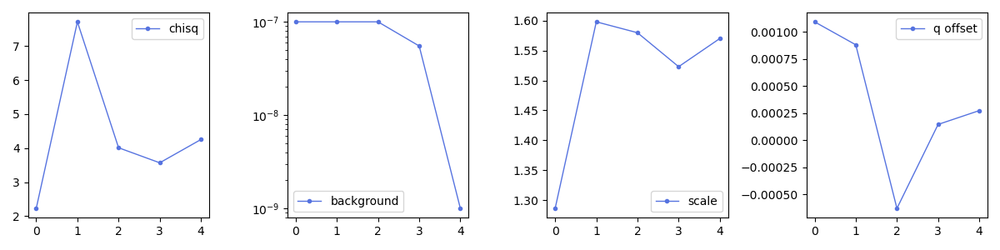

In [271]:
# This chooses one layer and plots all the different leghts 
%matplotlib widget
print(len(full_obj))
layer_ind =5
name_ind=0
ana_xrr.plot_obj_pane(full_obj[layer_ind], ['Data']*len(full_obj[layer_ind]), ind=len(full_obj[layer_ind])-1, path=img_pth, fname=layers[name_ind].replace('/', '-')+'_'+data_file[0:-4])

ana_xrr.compare_pars(full_pars[layer_ind], img_path=img_pth, fname=layers[name_ind].replace('/', '-')+'_'+data_file[0:-4])

In [275]:
layer_list = [layer.replace('/', '-') for layer in layers]
layer_list = np.linspace(1.5,2.5,6)
plot_ind = 0 
q_ind = 4
# outer is layers, inner is q range  
ana_xrr.plot_obj_pane(grab_ind(full_obj,q_ind), layer_list, ind=plot_ind, path=img_pth, fname='diff_layers_'+data_file[0:-4])

IndexError: list index out of range

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


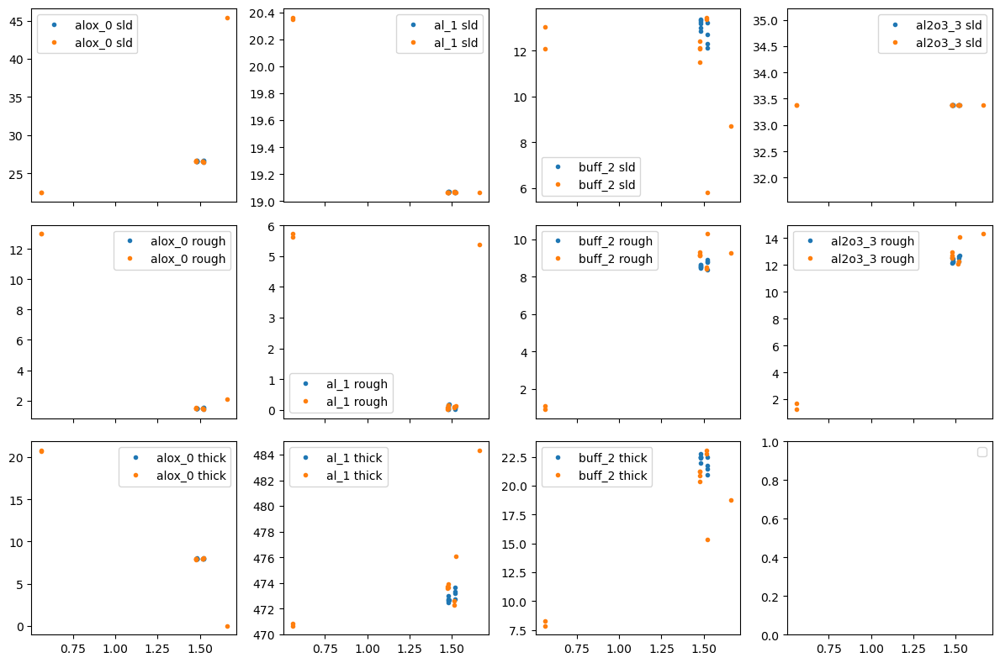

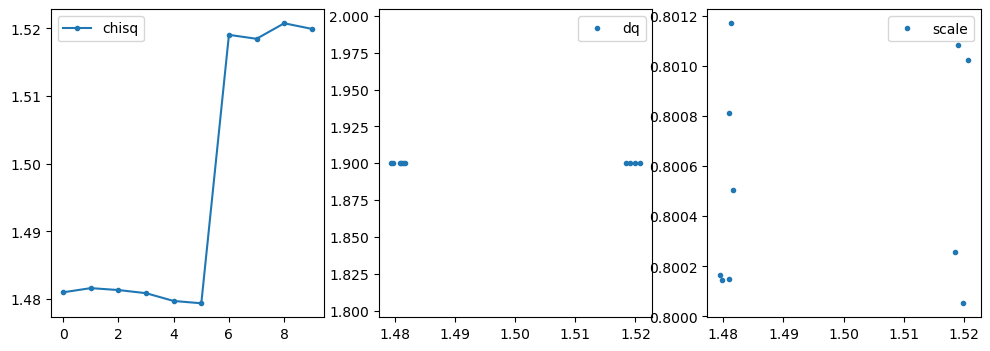

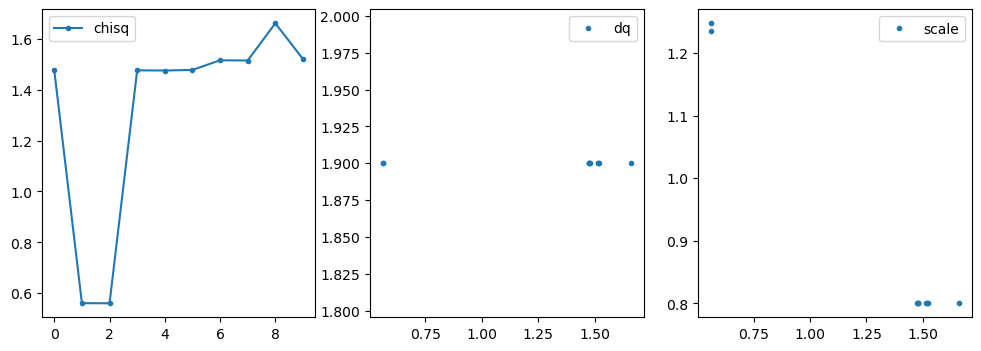

In [238]:
# fig, ax = plt.subplots(3,3, figsize=(9,9))
# ax = ax.flatten()
# ax[0].plot(wide['chisq'], wide['sld']['alox_0'],'.')
pars = [o[1] for o in outs]

sns.set_palette('tab10')

pp=wide

nlays = len(pp['sld'].keys())
fig, ax = plt.subplots(3, nlays, figsize=(nlays*3, 8), sharex=True)

ax = ax.flatten()
#thk=
for i, layer in enumerate(pp['sld'].keys()):
    #thk = pp['thick'][layer]+thk
    ax[i].plot(pp['chisq'], pp['sld'][layer], '.', label=layer+' '+'sld')
    ax[i+nlays].plot(pp['chisq'], pp['rough'][layer], '.', label=layer+' '+'rough')
    if i < nlays-1: 
        ax[i+2*nlays].plot(pp['chisq'], pp['thick'][layer], '.', label=layer+' '+'thick')
    #else: 
        #ax[i+2*nlays].plot(np.sum(pp['chisq'], pp['thick'][layer][0:-2]), '.-', label='total thick')

for a in ax: 
    a.legend()

fig.tight_layout()

fig2, ax2 = plt.subplots(1,3, figsize=(12, 4))
ax2[0].plot(pp['chisq'], '.-', label='chisq')
ax2[1].plot(pp['chisq'], pp['dq - resolution'], '.', label='dq')
ax2[2].plot(pp['chisq'], pp['scale'], '.', label='scale')
for a in ax2: 
    a.legend()

pp=narrow
for i, layer in enumerate(pp['sld'].keys()):
    #thk = pp['thick'][layer]+thk
    ax[i].plot(pp['chisq'], pp['sld'][layer], '.', label=layer+' '+'sld')
    ax[i+nlays].plot(pp['chisq'], pp['rough'][layer], '.', label=layer+' '+'rough')
    if i < nlays-1: 
        ax[i+2*nlays].plot(pp['chisq'], pp['thick'][layer], '.', label=layer+' '+'thick')
    #else: 
        #ax[i+2*nlays].plot(np.sum(pp['chisq'], pp['thick'][layer][0:-2]), '.-', label='total thick')

for a in ax: 
    a.legend()

fig.tight_layout()

fig, ax = plt.subplots(1,3, figsize=(12, 4))
ax[0].plot(pp['chisq'], '.-', label='chisq')
ax[1].plot(pp['chisq'], pp['dq - resolution'], '.', label='dq')
ax[2].plot(pp['chisq'], pp['scale'], '.', label='scale')
for a in ax: 
    a.legend()    

# Trilayers

52.8780359376036


6.052346640919357: : 205it [00:37,  5.50it/s]
/Users/sph/Library/CloudStorage/OneDrive-SharedLibraries-LLNL/MQC - JJ - Stanford - General/XRay/XRR/Code/ana_xrr.py:415: UserWarning: The figure layout has changed to tight
  fig.tight_layout()


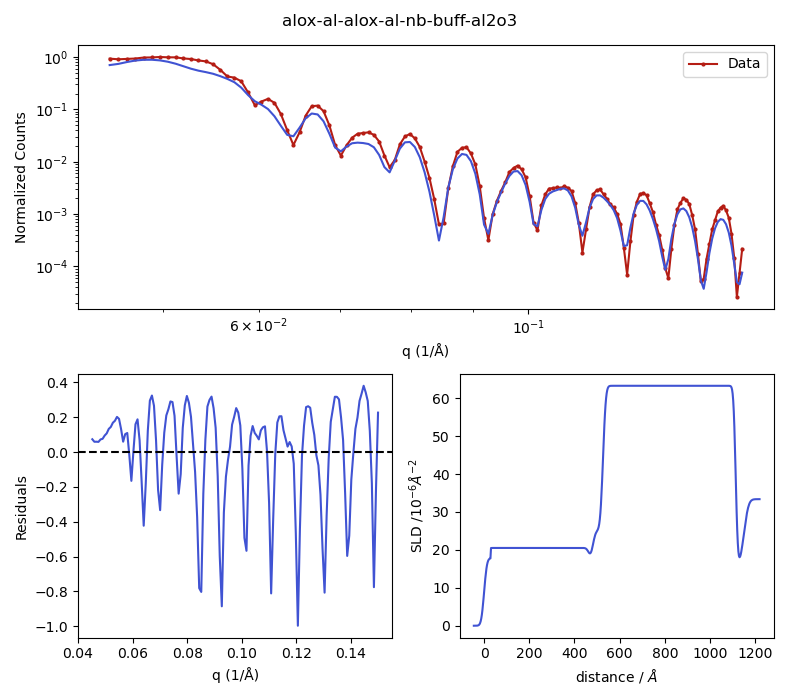

Layer Properties:
  Layer  Thickness (Å)  Roughness (Å)  SLD (10^-6 cm^-2)
 alox_0      29.459139      10.116809          17.811052
   al_1     435.444532       0.275097          20.514052
 alox_2      16.197383       8.964069          17.051400
   al_3      45.235847      10.000000          25.074948
   nb_4     587.332414      10.000000          63.287613
 buff_5      36.429872       7.909551          15.257555
al2o3_6            inf      16.041210          33.380000

Additional Parameters:
       Parameter     Value
           Chisq 12.086073
Log10 Background -9.000000
 DQ - Resolution  1.500000
        Q Offset  0.001094
           Scale  1.385563
78.28261388501852


12.418029143536485: : 104it [00:21,  4.80it/s]
/Users/sph/Library/CloudStorage/OneDrive-SharedLibraries-LLNL/MQC - JJ - Stanford - General/XRay/XRR/Code/ana_xrr.py:415: UserWarning: The figure layout has changed to tight
  fig.tight_layout()


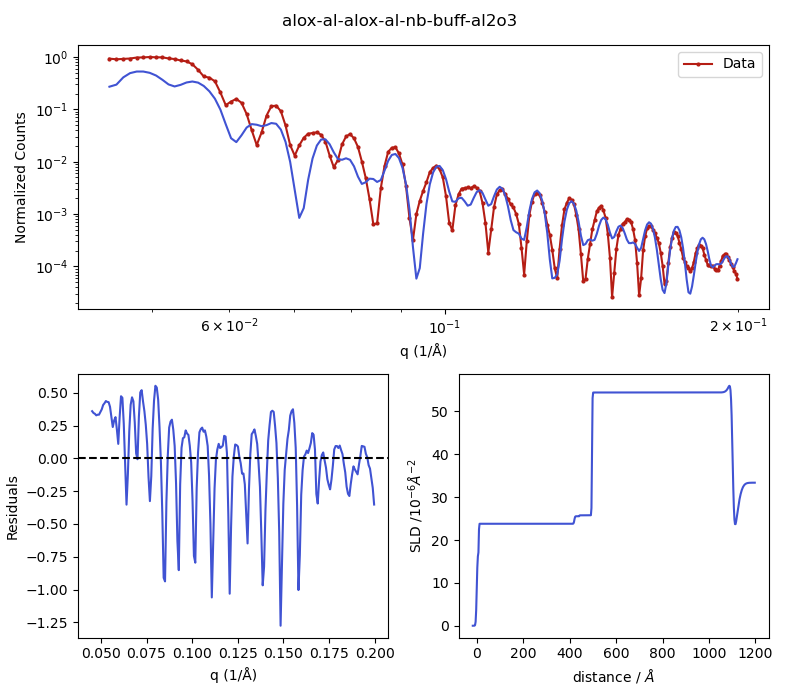

Layer Properties:
  Layer  Thickness (Å)  Roughness (Å)  SLD (10^-6 cm^-2)
 alox_0       9.000000       3.000000          17.051400
   al_1     411.306265       0.856124          23.794691
 alox_2      21.913293       2.289546          25.549420
   al_3      54.028956       0.541105          25.763014
   nb_4     605.402260       1.500000          54.429750
 buff_5      12.127729       5.814594          12.353116
al2o3_6            inf      19.558470          33.380000

Additional Parameters:
       Parameter     Value
           Chisq 24.570316
Log10 Background -9.000000
 DQ - Resolution  1.500000
        Q Offset -0.003859
           Scale  0.800000
103.11204871734198


15.170566170161587: : 82it [00:23,  3.55it/s]
/Users/sph/Library/CloudStorage/OneDrive-SharedLibraries-LLNL/MQC - JJ - Stanford - General/XRay/XRR/Code/ana_xrr.py:415: UserWarning: The figure layout has changed to tight
  fig.tight_layout()


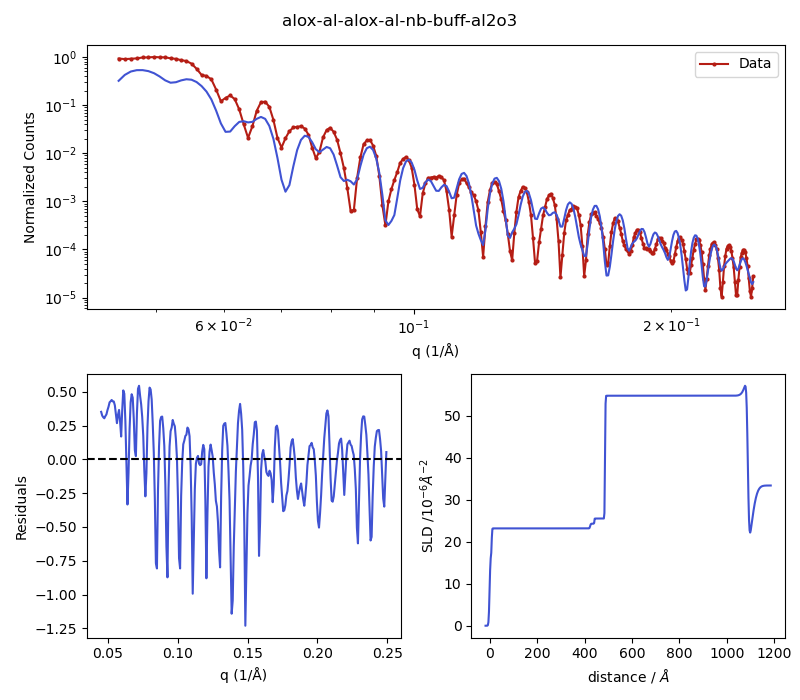

Layer Properties:
  Layer  Thickness (Å)  Roughness (Å)  SLD (10^-6 cm^-2)
 alox_0       9.000000       3.000000          17.051400
   al_1     414.780774       1.337796          23.169061
 alox_2      17.575841       2.165273          24.288904
   al_3      45.000000       0.787736          25.513142
   nb_4     601.454056       1.500000          54.750571
 buff_5      11.843126       4.704572          11.130989
al2o3_6            inf      19.955094          33.380000

Additional Parameters:
       Parameter     Value
           Chisq 29.836811
Log10 Background -9.000000
 DQ - Resolution  1.500000
        Q Offset -0.003188
           Scale  0.800000
126.70084145735329


17.45237933305142: : 93it [00:27,  3.38it/s] 
/Users/sph/Library/CloudStorage/OneDrive-SharedLibraries-LLNL/MQC - JJ - Stanford - General/XRay/XRR/Code/ana_xrr.py:415: UserWarning: The figure layout has changed to tight
  fig.tight_layout()


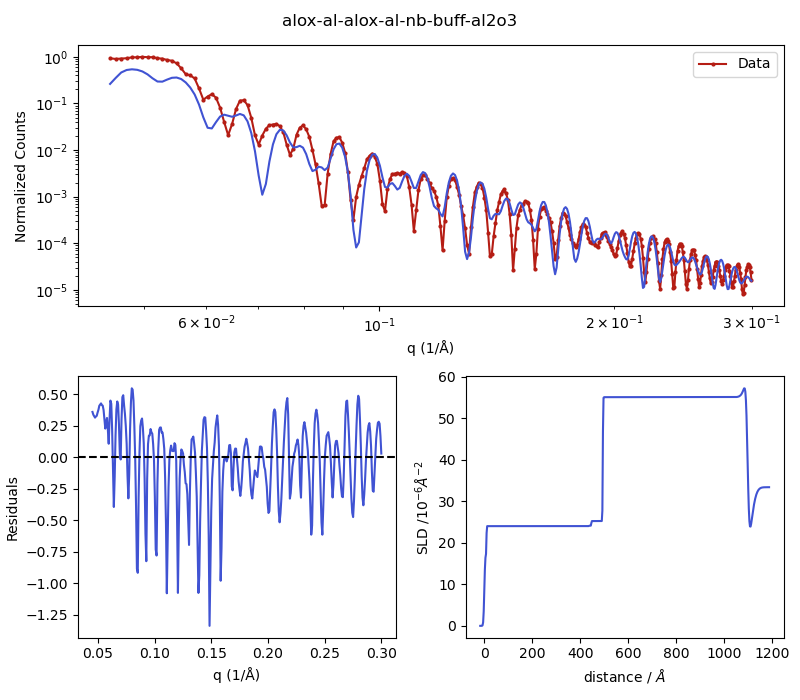

Layer Properties:
  Layer  Thickness (Å)  Roughness (Å)  SLD (10^-6 cm^-2)
 alox_0       8.974338       2.998054          17.402215
   al_1     426.950998       0.813387          24.005724
 alox_2       9.799965       1.684136          24.122025
   al_3      47.630809       0.664535          25.227022
   nb_4     603.128279       1.223020          55.057690
 buff_5       9.316055       5.863933           9.802192
al2o3_6            inf      18.788043          33.380000

Additional Parameters:
       Parameter     Value
           Chisq 34.868082
Log10 Background -6.301030
 DQ - Resolution  1.500000
        Q Offset -0.003423
           Scale  0.810596
155.93173828159388


20.25422928493087: : 75it [00:24,  3.02it/s] 


KeyboardInterrupt: 

In [14]:
qrng = [0.045, 0.15]
par={'scale':1, 'bkg':5e-9, 'q_offset':0, 'dq - resolution':1.5, 'sub_rough_max':20}
par['thk']= [6, 400, 15, 50, 570,10, np.inf]
lay = 'alox/al/alox/al/nb/buff/al2o3'
outs=[]
#obj, par2 = ana_xrr.sim(pth + flist[13], 'alox/al/alox/nb/buff/al2o3', par, qrng)
for i in range(10):
    if i>0:        
    #obj, par = ana_xrr.refit(obj, pth + flist[13], qrng, fname='al-nb', img_path=img_pth)
        outs.append(ana_xrr.sim(pth + flist[8], lay, par, qrng, careful=True))
    else:
        outs.append(ana_xrr.sim(pth + flist[8], lay, par, qrng))
    qrng[1]=qrng[1]+0.05
    ana_xrr.generate_table(outs[-1][1])
    

# Compare Al/Nb models

### Fit several models

In [ ]:

# out_lists has length layers, and is a list with different qrngs
%matplotlib inline
par={'scale':1, 'bkg':1e-8, 'q_offset':0, 'dq - resolution':0.5, 'sub_rough_max':25}
qrng = [0.05, 0.15]
layers = ['taox/ta/taox/sio2'] 

SLD_rng = [0.65, 0.1]
data_file = flist[15]
for i in range(len(layers)): 
    layers[i]=layers[i]+ '/si'

def run_simulation(i, j, k, layers, flist, qrng, SLD_rng):
    qrng[1] = 0.15 + 0.05 * i + 0.025 * i ** 2
    par = {'scale': 1, 'bkg': 5e-9, 'q_offset': 0, 'dq - resolution': 0.5, 'sub_rough_max': 20, 'x_err': 1.9}
    par['thk'] = [60, 570]
    return ana_xrr.sim(pth + flist[k], layers[j], par, qrng, SLD_rng=SLD_rng, img_path='../Outputs/')

results = Parallel(n_jobs=-1)(delayed(run_simulation)(i, j, k, layers, f, qrng.copy(), SLD_rng) for k in range(len(f)) for i in tqdm(range(7), desc="Outer Loop") for j in tqdm(range(len(layers)), desc="Inner Loop", leave=False))

#results = Parallel(n_jobs=-1)(delayed(run_simulation)(i, j, layers, data_file, qrng.copy(), SLD_rng) for i in range(6) for j in range(len(layers)))

































































































































Outer Loop: 100%|██████████| 7/7 [00:00<00:00, 11.82it/s]




























































































































































Outer Loop: 100%|██████████| 7/7 [1:13:56<00:00, 633.74s/it]





















































































































































Outer Loop: 100%|██████████| 7/7 [2:37:41<00:00, 1351.63s/it]  





















































































































































Outer Loop: 100%|██████████| 7/7 [2:41:43<00:00, 1386.20s/it]  





















































































































































Outer Loop: 100%|██████

In [ ]:

# out_lists has length layers, and is a list with different qrngs
%matplotlib inline
par={'scale':1, 'bkg':5e-9, 'q_offset':0, 'dq - resolution':0.5, 'sub_rough_max':23}
qrng = [0.05, 0.15]
layers = ['alox/al/nb','alox/al/nb/buff_low','alox/al/nbox/nb/buff_low','alox/al/nb/buff','alox/al/alox/nb/buff_low','alox/al/nb/buff_low', 'alox/alox/al/nbox/nb/buff_low','alox/alox/al/nbox/nb/buff_low/buff', 'alox/alox/al/nbox/nb/buff_low/buff/buff'] 


layers = ['alox/al/nb/buff_low','alox/al/nb/buff']

SLD_rng = [0.65, 0.1]
data_file = flist[15]
for i in range(len(layers)): 
    layers[i]=layers[i]+ '/al2o3'

def run_simulation(i, j, k, layers, flist, qrng, SLD_rng):
    qrng[1] = 0.15 + 0.05 * i + 0.025 * i ** 2
    par = {'scale': 1, 'bkg': 5e-9, 'q_offset': 0, 'dq - resolution': 0.5, 'sub_rough_max': 20, 'x_err': 1.9}
    par['thk'] = [30, 60, 570, 100]
    return ana_xrr.sim(pth + flist[k], layers[j], par, qrng, SLD_rng=SLD_rng, img_path='../Outputs/')

results = Parallel(n_jobs=-1)(delayed(run_simulation)(i, j, k, layers, f, qrng.copy(), SLD_rng) for k in range(len(f)) for i in tqdm(range(7), desc="Outer Loop") for j in tqdm(range(len(layers)), desc="Inner Loop", leave=False))

#results = Parallel(n_jobs=-1)(delayed(run_simulation)(i, j, layers, data_file, qrng.copy(), SLD_rng) for i in range(6) for j in range(len(layers)))


In [171]:
results[63*4][0].data.y

array([1.00000000e+00, 9.84272852e-01, 9.50298308e-01, 9.31655980e-01,
       8.95628456e-01, 8.82382027e-01, 8.43645267e-01, 7.75685902e-01,
       6.56459155e-01, 4.96241976e-01, 4.33200474e-01, 4.18441532e-01,
       3.56705231e-01, 2.30195203e-01, 1.30945568e-01, 1.16868991e-01,
       1.41931274e-01, 1.52762843e-01, 1.34422501e-01, 1.01566647e-01,
       6.54199354e-02, 3.64582727e-02, 3.12260031e-02, 5.16346807e-02,
       9.04939610e-02, 1.24468753e-01, 1.33483902e-01, 1.18714529e-01,
       8.10573740e-02, 4.54726276e-02, 1.99590996e-02, 1.09022931e-02,
       1.32260599e-02, 1.94087185e-02, 2.62783077e-02, 3.24797272e-02,
       3.91387228e-02, 4.37364798e-02, 4.33772564e-02, 3.85180425e-02,
       2.71909900e-02, 1.71997265e-02, 1.13056083e-02, 1.22505287e-02,
       1.90624140e-02, 2.67161229e-02, 3.18353086e-02, 3.12137642e-02,
       2.68359301e-02, 2.04673881e-02, 1.40178579e-02, 1.00111409e-02,
       6.68202080e-03, 4.27516651e-03, 2.24912112e-03, 1.60450896e-03,
      

In [186]:
results_3d = [[[None for _ in range(9)] for _ in range(7)] for _ in range(9)]

for i in range(9):
    for j in range(7):
        for k in range(9):
            results_3d[i][j][k] = results[i * 63 + j * 9 + k]

print(results_3d)

[[[(Objective(ReflectModel(Structure(components=[Slab(Parameter(value=inf, name='air - thick', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), SLD([Parameter(value=0.0, name='air - sld', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), Parameter(value=0.0, name='air - isld', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None)], name='air'), Parameter(value=0.0, name='air - rough', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), name='air', vfsolv=Parameter(value=0.0, name='air - volfrac solvent', vary=False, bounds=Interval(lb=0.0, ub=1.0), constraint=None), interface=None), Slab(Parameter(value=39.26257969814555, name='alox_0 - thick', vary=True, bounds=Interval(lb=0.0, ub=40.0), constraint=None), SLD([Parameter(value=16.13661189854571, name='alox_0 - sld', vary=True, bounds=Interval(lb=16.1041, ub=46.891349999999996), constraint=None), Parameter(value=-0.37, name='alox_0 - isld', vary=False, bounds=Inte

In [187]:
results_3d_swapped = [[[results_3d[i][k][j] for k in range(len(results_3d[i]))] for j in range(len(results_3d[i][0]))] for i in range(len(results_3d))]

print(results_3d_swapped)

[[[(Objective(ReflectModel(Structure(components=[Slab(Parameter(value=inf, name='air - thick', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), SLD([Parameter(value=0.0, name='air - sld', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), Parameter(value=0.0, name='air - isld', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None)], name='air'), Parameter(value=0.0, name='air - rough', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), name='air', vfsolv=Parameter(value=0.0, name='air - volfrac solvent', vary=False, bounds=Interval(lb=0.0, ub=1.0), constraint=None), interface=None), Slab(Parameter(value=39.26257969814555, name='alox_0 - thick', vary=True, bounds=Interval(lb=0.0, ub=40.0), constraint=None), SLD([Parameter(value=16.13661189854571, name='alox_0 - sld', vary=True, bounds=Interval(lb=16.1041, ub=46.891349999999996), constraint=None), Parameter(value=-0.37, name='alox_0 - isld', vary=False, bounds=Inte

In [229]:
results_3d_swapped[1][0][0][0].chisqr()

6.41823319522957

In [236]:
full_obj = [[[None for _ in range(len(results_3d_swapped[0][0]))] for _ in range(len(results_3d_swapped[0]))] for _ in range(len(results_3d_swapped))]

for i in range(len(results_3d_swapped)):
    for j in range(len(results_3d_swapped[i])):
        for k in range(len(results_3d_swapped[i][j])):
            full_obj[i][j][k] = results_3d_swapped[i][j][k][0]

print(full_obj)

[[[Objective(ReflectModel(Structure(components=[Slab(Parameter(value=inf, name='air - thick', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), SLD([Parameter(value=0.0, name='air - sld', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), Parameter(value=0.0, name='air - isld', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None)], name='air'), Parameter(value=0.0, name='air - rough', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), name='air', vfsolv=Parameter(value=0.0, name='air - volfrac solvent', vary=False, bounds=Interval(lb=0.0, ub=1.0), constraint=None), interface=None), Slab(Parameter(value=39.26257969814555, name='alox_0 - thick', vary=True, bounds=Interval(lb=0.0, ub=40.0), constraint=None), SLD([Parameter(value=16.13661189854571, name='alox_0 - sld', vary=True, bounds=Interval(lb=16.1041, ub=46.891349999999996), constraint=None), Parameter(value=-0.37, name='alox_0 - isld', vary=False, bounds=Inter

In [238]:
full_obj[1][0][0].chisqr()

6.41823319522957

In [235]:
full_obj = [[None] * len(results_3d_swapped)]*len(results_3d_swapped[0])
for i, o in enumerate(results_3d_swapped):
    print(o[0][0][0].chisqr())
    for j, p in enumerate(o):
        #print(p[0][0].chisqr())
        full_obj[i][j] = [oo[0] for oo in p]

4.312989866239402
6.41823319522957
4.737701862396138
3.5210879505858568
4.12208753947669
3.0158883527482727
2.984863960956659
5.075806542057741
3.8798363524955626


In [232]:
full_obj[1][0][0].chisqr()

3.8798363524955626

In [56]:

out_lists = [[[] for _ in range(len(layers))] for _ in range(len(f))] 


In [97]:
out_lists[6][3][0][0]

Objective(ReflectModel(Structure(components=[Slab(Parameter(value=inf, name='air - thick', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), SLD([Parameter(value=0.0, name='air - sld', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), Parameter(value=0.0, name='air - isld', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None)], name='air'), Parameter(value=0.0, name='air - rough', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), name='air', vfsolv=Parameter(value=0.0, name='air - volfrac solvent', vary=False, bounds=Interval(lb=0.0, ub=1.0), constraint=None), interface=None), Slab(Parameter(value=38.87436918130892, name='alox_0 - thick', vary=True, bounds=Interval(lb=0.0, ub=40.0), constraint=None), SLD([Parameter(value=16.431088567331606, name='alox_0 - sld', vary=True, bounds=Interval(lb=16.1041, ub=46.891349999999996), constraint=None), Parameter(value=-0.37, name='alox_0 - isld', vary=False, bounds=Interva

In [182]:
for i in range(len(f)):
    for j in range(7): # for range 
        for k in range(len(layers)):
            out_lists[i][k].append(results[i*7*len(layers) + j * len(layers) + k])


In [183]:
for i, o in enumerate(out_lists):
    for j, p in enumerate(o):
        full_obj[i][j] = [oo[0] for oo in p]

In [209]:
full_obj[3][5][2].chisqr()

24.439439133320455

In [66]:

full_obj = ana_xrr.collect_obj3(out_lists)
full_pars = ana_xrr.collect_pars(out_lists)      

IndexError: list index out of range

In [198]:
out_lists[4][3][0][0].chisqr()

39.62864331684739

In [ ]:

           #0  top    1  top/bot          2  top/mid/bot                4 top/bot/bot
# layers = ['alox/al/nb','alox/al/nb/buff_low','alox/al/nbox/nb/buff_low','alox/al/nb/buff_low/buff',
#            #5  top/mid/mid/bot                               
#           'alox/al/alox/nbox/nb/buff_low',
#           # 6 top/top/bot        8 top/top/mid/bot            9 top/top/mid/bot/bot              top/top/mid/mid/bot/bot
#           'buff/alox/al/nb/buff_low', 'buff/alox/al/nbox/nb/buff_low','buff/alox/al/nbox/nb/buff_low/buff', 'buff/buff/alox/al/nbox/nb/buff_low/buff']

layers = ['alox/al/nbox/nb/buff_low','alox/al/nb/buff_low/buff',
#           5  top/mid/mid/bot                               
#layers=['alox/al/nbox/nb/buff_low']
#          6 top/top/bot        8 top/top/mid/bot            9 top/top/mid/bot/bot              top/top/mid/mid/bot/bot
          'buff/alox/al/nb/buff_low', 'buff/alox/al/nbox/nb/buff_low','buff/alox/al/nbox/nb/buff_low/buff', 'buff/buff/alox/al/nbox/nb/buff_low/buff']



# layers = ['alox/al/nb','alox/al/nb/buff','alox/al/alox/nb/buff','alox/al/nb/alox/buff','alox/al/nb/buff/alox',
#           # 5 top/mid/bot/bot       6  top/mid/mid/bot                               
#           'alox/al/alox/nb/alox/buff','alox/al/buff/alox/nb/buff',
#           # 7 top/top/bot        8 top/top/mid/bot            9 top/top/mid/bot/bot              top/top/mid/mid/bot/bot
#           'alox/alox/al/nb/buff', 'alox/alox/al/alox/nb/buff','alox/alox/al/alox/nb/buff/alox', 'alox/alox/al/alox/alox/nb/buff/alox']





for i in range(6): 
    qrng[1]=0.15 + 0.05*i+0.025*i**2
    for j in range(len(layers)):
        par = {'scale':1, 'bkg':5e-9, 'q_offset':0, 'dq - resolution':0.5, 'sub_rough_max':20, 'x_err':1.9}
        par['thk']=[60, 570]
        out_lists[j].append(ana_xrr.sim(pth + data_file, layers[j], par, qrng, SLD_rng=SLD_rng))

full_obj = ana_xrr.collect_obj(out_lists)
full_pars = ana_xrr.collect_pars(out_lists)

6.297816759262312: : 982it [1:07:22,  4.12s/it] 
/Users/sph/Library/CloudStorage/OneDrive-SharedLibraries-LLNL/MQC - JJ - Stanford - General/XRay/XRR/Code/ana_xrr.py:483: UserWarning: The figure layout has changed to tight
  fig.tight_layout()


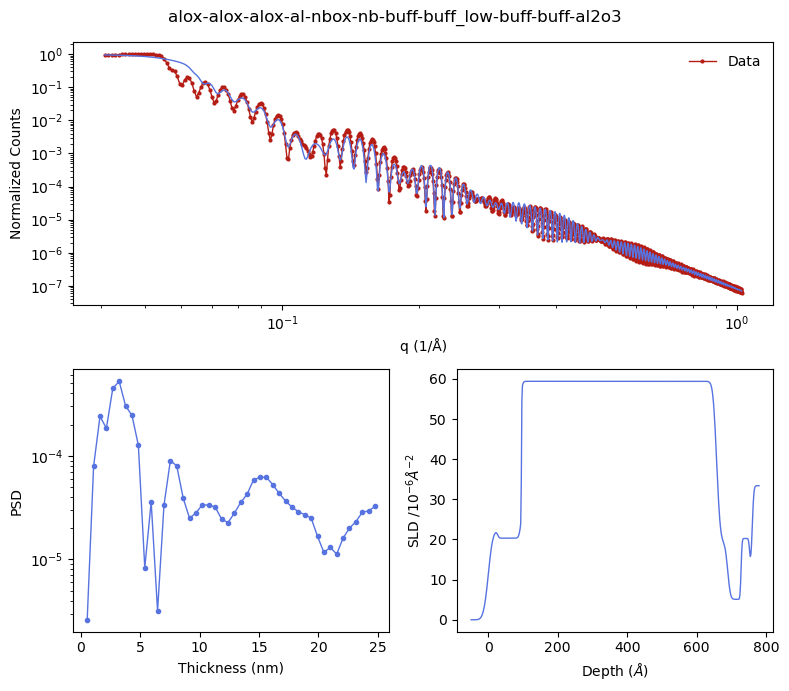

In [314]:
# out_lists has length layers, and is a list with different qrngs
%matplotlib inline
par={'scale':1, 'bkg':5e-9, 'q_offset':0, 'dq - resolution':0.5, 'sub_rough_max':23}
qrng = [0.04, 0.15]
        
#layers = ['alox/al/nb','alox/al/nb/buff_low','alox/al/nb/buff_med','alox/al/nb/buff','alox/al/nb/alox']#,'alox/al/nbox/nb/buff_low','alox/al/nbox/nb/buff_med',
#layers = ['alox/al/nb/buff_low','alox/al/nbox/nb/buff_low','alox/al/alox/nb/buff_low','alox/al/buff/nb/buff_low']
#layers = ['alox/alox/al/nbox/nb/buff_low', 'buff/alox/al/nbox/nb/buff_low','alox/buff/al/nbox/nb/buff_low']
layers = ['alox/alox/alox/al/nbox/nb/buff/buff_low/buff/buff']

for i in range(len(layers)): 
    layers[i]=layers[i]+ '/al2o3'

out_lists = [[] for _ in range(len(layers))]
SLD_rng = [0.45, 0.1]
data_file = flist[16]

for i in range(5,6): 
    qrng[1]=0.15 + 0.05*i+0.025*i**2
    for j in range(len(layers)):
        par = {'scale':1, 'bkg':5e-9, 'q_offset':0, 'dq - resolution':0.5, 'sub_rough_max':20, 'x_err':1.9}
        par['thk']=[60, 570]
        out_lists[j].append(ana_xrr.sim(pth + data_file, layers[j], par, qrng, SLD_rng=SLD_rng, img_path=img_pth))

full_obj = ana_xrr.collect_obj(out_lists)
full_pars = ana_xrr.collect_pars(out_lists)

### Multiple Nb and Al layers 

4.540102434243459: : 1000it [42:27,  2.55s/it]
/Users/sph/Library/CloudStorage/OneDrive-SharedLibraries-LLNL/MQC - JJ - Stanford - General/XRay/XRR/Code/ana_xrr.py:712: UserWarning: The figure layout has changed to tight
  if save:


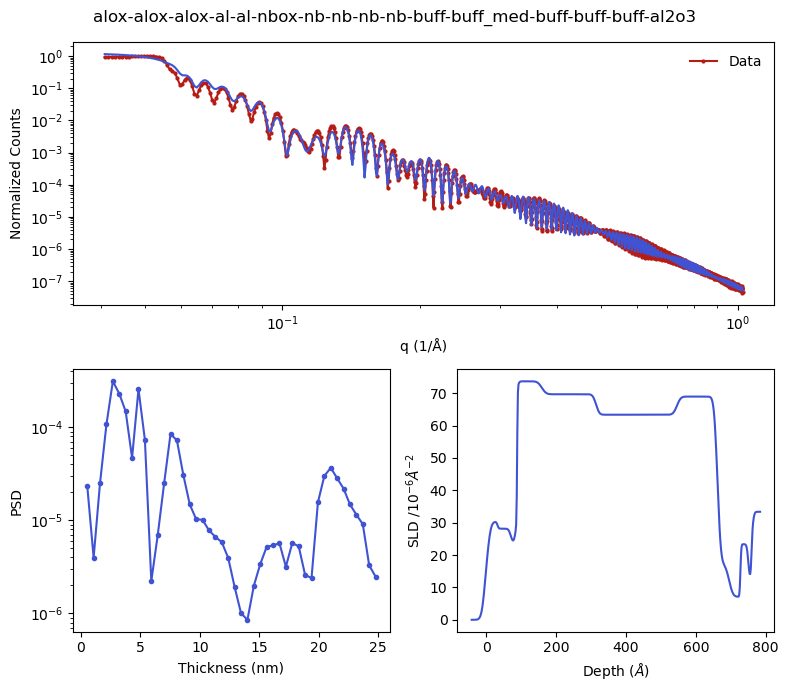

In [11]:
# out_lists has length layers, and is a list with different qrngs
%matplotlib inline
par={'scale':1, 'bkg':5e-9, 'q_offset':0, 'dq - resolution':0.5, 'sub_rough_max':23}
qrng = [0.04, 0.15]
        
layers = ['alox/alox/alox/al/al/nbox/nb/nb/nb/nb/buff/buff_med/buff/buff/buff']

for i in range(len(layers)): 
    layers[i]=layers[i]+ '/al2o3'

out_lists = [[] for _ in range(len(layers))]
SLD_rng = [0.3, 0.1]
data_file = flist[15]

for i in range(5,6): 
    qrng[1]=0.15 + 0.05*i+0.025*i**2
    for j in range(len(layers)):
        par = {'scale':1, 'bkg':5e-9, 'q_offset':0, 'dq - resolution':0.5, 'sub_rough_max':20, 'x_err':1.9}
        if j==0:
            par['thk']=[43,15, 70, 175, 235,110]
        if j==1:
            par['thk']=[60, 100, 250, 220]
        if j==2:
            par['thk']=[60, 100, 200, 170,100]
        out_lists[j].append(ana_xrr.sim(pth + data_file, layers[j], par, qrng, SLD_rng=SLD_rng, img_path=img_pth))

full_obj = ana_xrr.collect_obj(out_lists)
full_pars = ana_xrr.collect_pars(out_lists)

### Run single

3.463077826061032: : 390it [05:07,  1.27it/s] 


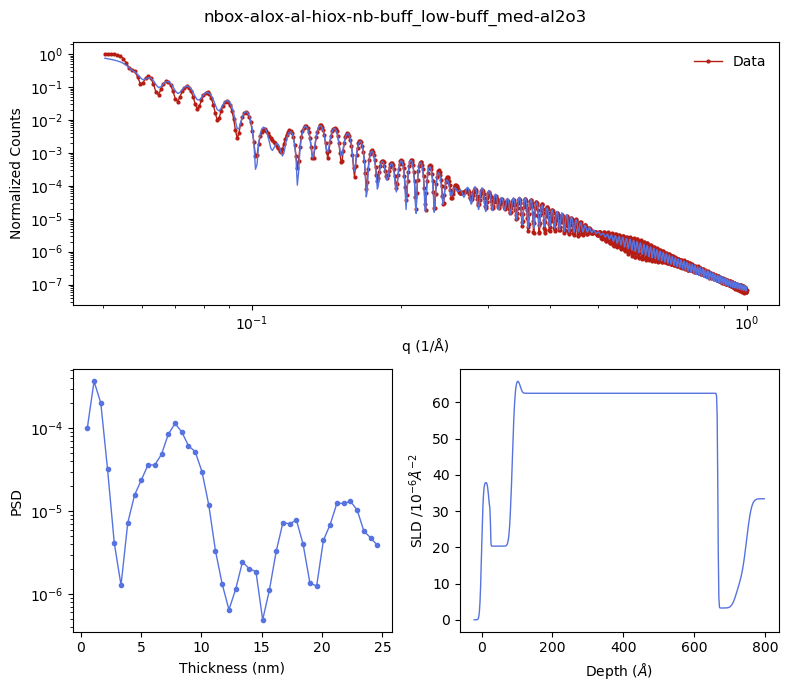

In [203]:
# out_lists has length layers, and is a list with different qrngs
%matplotlib inline
par={'scale':1, 'bkg':5e-9, 'q_offset':0, 'dq - resolution':0.5, 'sub_rough_max':23}
qrng = [0.05, 1]
        
#layers = ['alox/al/nb','alox/al/nb/buff_low','alox/al/nb/buff_med','alox/al/nb/buff','alox/al/nb/alox']#,'alox/al/nbox/nb/buff_low','alox/al/nbox/nb/buff_med',
#layers = ['alox/al/nb/buff_low','alox/al/nbox/nb/buff_low','alox/al/alox/nb/buff_low','alox/al/buff/nb/buff_low']
#layers = ['alox/alox/al/nbox/nb/buff_low', 'buff/alox/al/nbox/nb/buff_low','alox/buff/al/nbox/nb/buff_low']
layers = ['nbox/alox/al/hiox/nb/buff_low/buff_med']

for i in range(len(layers)): 
    layers[i]=layers[i]+ '/al2o3'

out_lists = [[] for _ in range(len(layers))]
#SLD_rng = [0.4, 0.075]
SLD_rng = [0.35, 0.1]
data_file = flist[15]
j=0
par = {'scale':1, 'bkg':5e-9, 'q_offset':0, 'dq - resolution':0.5, 'sub_rough_max':20, 'x_err':1.9}
par['thk']=[60, 570]
obj, par = ana_xrr.sim(pth + data_file, layers[j], par, qrng, SLD_rng=SLD_rng, img_path=img_pth)



### Plot different ranges

9


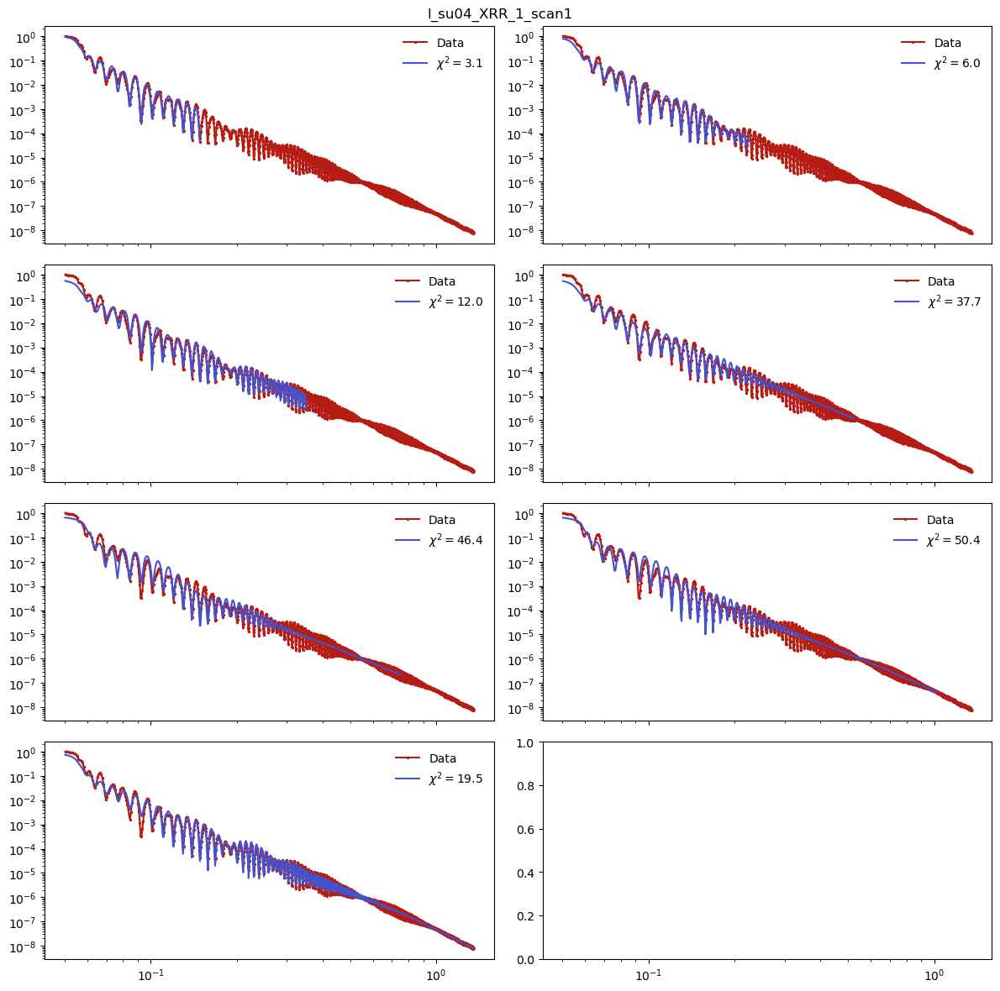

In [248]:
# This chooses one layer and plots all the different leghts 
print(len(full_obj))
layer_ind = 1
find=4
ana_xrr.plot_obj_pane(full_obj[find][layer_ind], ['Data']*len(full_obj[find][layer_ind]), ind=len(full_obj[find][layer_ind])-1, path=img_pth, fname=layers[find][layer_ind].replace('/', '-')+'_'+f[find][0:-4])

#ana_xrr.compare_pars(full_pars[layer_ind], img_path=img_pth, fname=layers[layer_ind].replace('/', '-')+'_'+data_file[0:-4])

In [78]:
# See what happens if you delete a layer 
curr_pars = deepcopy(full_pars[1][1])
rem_ind = 3
curr_pars['thk'] = np.delete(curr_pars['thk'], rem_ind)
curr_pars['rough'] = np.delete(curr_pars['rough'], rem_ind)
curr_pars['sld'] = np.delete(curr_pars['sld'], rem_ind)


In [88]:
%matplotlib qt
fig,ax = plt.subplots(1,1, figsize=(7,4.5), num=20)
f = flist[16]
data = ana_xrr.loadRefData(os.path.join(pth,f)) 
#ax.semilogy(data.x, data.y,linewidth=1, label=f[0:4])
#ax=ana_xrr.plot_model('alox/al/nb/buff_low/al2o3',params=full_pars[1][0], ax=ax)
#ax=ana_xrr.plot_model('alox/al/nb/buff_low/al2o3',params=full_pars[1][1], ax=ax)
ax=ana_xrr.plot_model('alox/al/nb/buff_low/al2o3',params=full_pars[1][1], ax=ax)
ax=ana_xrr.plot_model('alox/al/nb/al2o3',params=curr_pars, ax=ax)

In [38]:
len(full_obj[0][0])

2

In [106]:
full_obj[2][0][0]

Objective(ReflectModel(Structure(components=[Slab(Parameter(value=inf, name='air - thick', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), SLD([Parameter(value=0.0, name='air - sld', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), Parameter(value=0.0, name='air - isld', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None)], name='air'), Parameter(value=0.0, name='air - rough', vary=False, bounds=Interval(lb=-np.inf, ub=np.inf), constraint=None), name='air', vfsolv=Parameter(value=0.0, name='air - volfrac solvent', vary=False, bounds=Interval(lb=0.0, ub=1.0), constraint=None), interface=None), Slab(Parameter(value=25.784908211731242, name='alox_0 - thick', vary=True, bounds=Interval(lb=0.0, ub=40.0), constraint=None), SLD([Parameter(value=16.74288232652664, name='alox_0 - sld', vary=True, bounds=Interval(lb=16.1041, ub=46.891349999999996), constraint=None), Parameter(value=-0.37, name='alox_0 - isld', vary=False, bounds=Interva

### Plot different layer sets

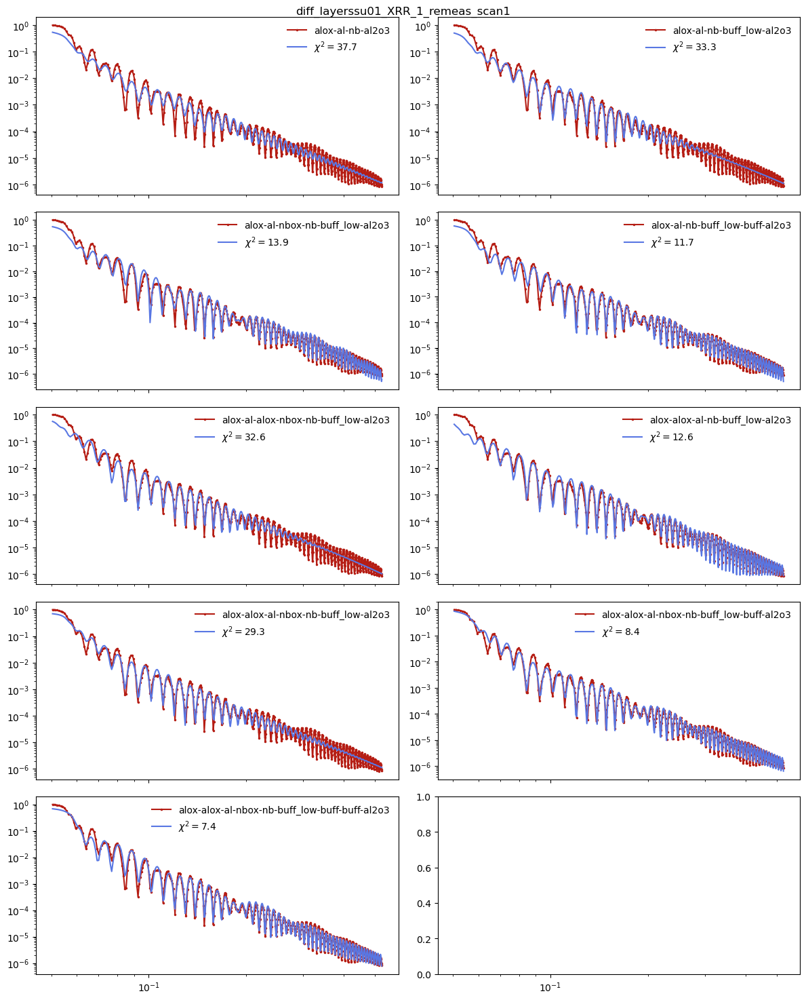

In [282]:
layer_list = [layer.replace('/', '-') for layer in layers]
plot_ind = 0 # Which data to plot 
q_ind = 3 # Which fit to plot 
find =0

# outer is layers, inner is q range  
ana_xrr.plot_obj_pane(grab_ind(full_obj[find],q_ind), layer_list, ind=plot_ind, path=img_pth, fname='diff_layers'+f[find][0:-4])

In [260]:

chisqr = np.zeros((9, 9, 7))

for i in range(9):
    for j in range(9):
        for k in range(7):
            chisqr[i, j, k] = results_3d_swapped[i][j][k][0].chisqr()

print(chisqr)

[[[ 4.31298987 12.16506446 30.53424319 37.67835664 23.74813754
   27.62526334 45.26812865]
  [ 3.30627991  5.81364272 11.91624721 33.31112335 35.67459018
   39.0515185  43.138583  ]
  [ 2.83957719  3.84281535 18.83871389 13.90354531 31.94576652
   33.88421036 36.57212917]
  [ 2.94660535  6.46224675 11.27462744 11.73365036 39.62864332
   21.67929614 24.08449307]
  [ 2.86056897  7.10620875  6.9561178  32.57184515 31.92292201
   33.67270219 34.17083339]
  [ 3.5320381   4.50666571  7.69781633 12.55856474  9.65713663
   42.3444372  42.78953202]
  [ 3.32182317  3.93680519  5.05040113 29.31947699 30.6939733
   34.8145801  35.72499253]
  [ 3.53114493  4.00007515  5.57534669  8.42013768 13.59249287
   18.66435517 20.59165491]
  [ 2.46878336  3.50705393  4.67800872  7.43717271 12.94875963
   16.20189858 16.60102014]]

 [[ 6.4182332  10.43285205 14.80443467 11.59960813 21.74422514
   18.34781107 45.01193541]
  [ 2.67887288  4.88561629  9.13919481 12.91006787 15.48949719
   39.93673312 15.39587689

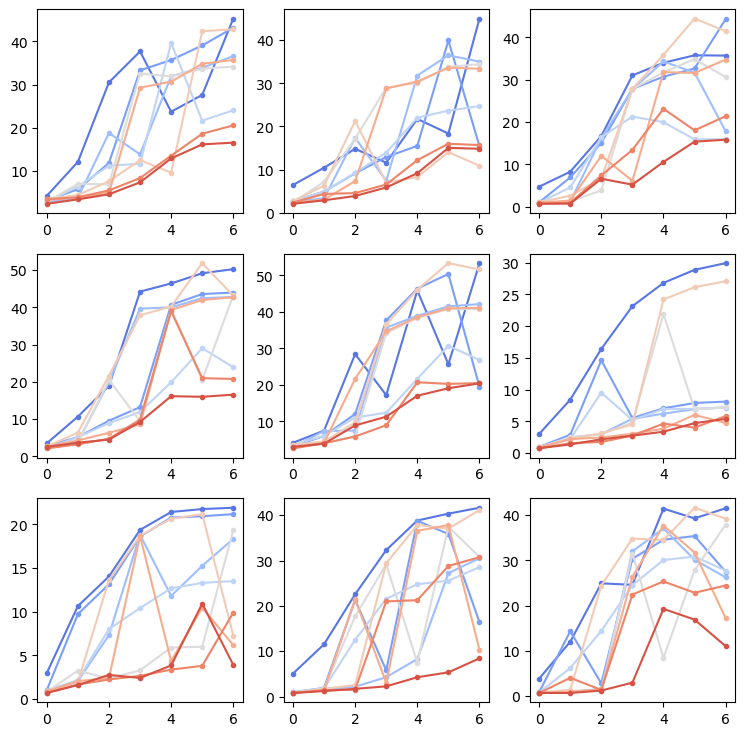

In [269]:
sns.set_palette('coolwarm',9)
fig, ax = plt.subplots(3,3, figsize=(9,9))
ax = ax.flatten()

for i in range(9):
    for j in range(9):
        ax[i].plot(chisqr[i,j,:], '.-', label='top')
#ax[0].plot(chisqr[:,0,0], '.-', label='top')
plt.show()

# Compare results

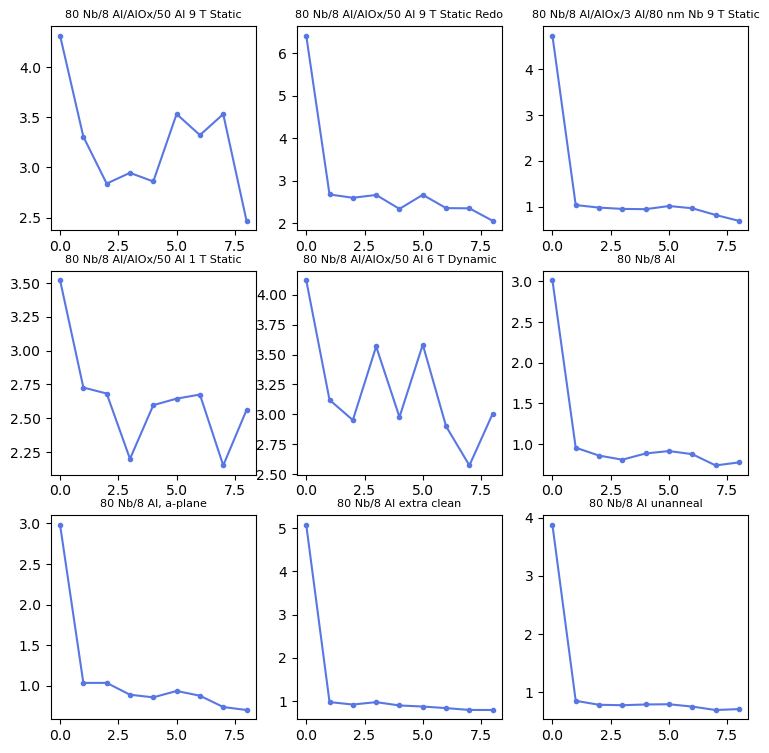

In [280]:
sns.set_palette('coolwarm',9)
fig, ax = plt.subplots(3,3, figsize=(9,9))
ax = ax.flatten()

for i in range(9):
        ax[i].plot(chisqr[i,:,0], '.-', label='top')
        ax[i].set_title(labs_stan[i], fontsize=8)
        #ax[i].plot(chisqr[i,:,1], '.-', label='top')
        #ax[i].plot(chisqr[i,:,6], '.-', label='top')
#ax[0].plot(chisqr[:,0,0], '.-', label='top')
plt.show()

In [276]:
len(labs_stan)

5

In [283]:
for i in range(len(chisqr)):
    min_value = np.min(chisqr[i, :, 6])
    print(min_value)

16.601020135560255
10.887497852181383
15.825796829914076
16.577962700482043
19.47146908867093
4.742562473222671
3.910691256234485
8.439716216962088
11.038221956751164


In [1]:
num_rng = 7
r, full_obj, full_pars = ana_xrr.rearrange_results(results, [len(f), num_rng, len(layers)])

NameError: name 'ana_xrr' is not defined

In [284]:
import pickle

# Save the list of objects to a file
with open('full_obj.pkl', 'wb') as file:
    pickle.dump(full_obj, file)

### Print tables

In [60]:
layer_ind = 7
q_ind = 3
ana_xrr.generate_table(out_lists[layer_ind][q_ind][1])

layer_ind = 8
q_ind = 5
ana_xrr.generate_table(out_lists[layer_ind][q_ind][1])
#print(out_lists[2][0][0])

Layer Properties:
     Layer  Thickness (Å)  Roughness (Å)  SLD (10^-6 cm^-2)
    alox_0      22.807341       3.629349          25.751312
    alox_1       0.009371      12.978003          41.994525
      al_2      60.205340       3.962752          20.575229
    nbox_3       7.162559       2.773453          29.466231
      nb_4     576.124280       6.712395          61.788614
buff_low_5      47.472125       2.190384           7.234550
    buff_6      42.852307       6.461947          13.139815
   al2o3_7            inf      12.152791          33.380000

Additional Parameters:
       Parameter     Value
           Chisq  2.670270
Log10 Background -6.301030
 DQ - Resolution  0.500000
        Q Offset -0.000004
           Scale  1.497161
Layer Properties:
     Layer  Thickness (Å)  Roughness (Å)  SLD (10^-6 cm^-2)
    alox_0      26.581969       7.554149          16.269011
    alox_1       0.126186      14.655082          37.123796
      al_2      55.200943       7.758319          20.73337

Would be nice to ploit them for extended segment 


### Compare x err

9.325639334831836: : 508it [10:05,  1.19s/it] 
/Users/sph/Library/CloudStorage/OneDrive-SharedLibraries-LLNL/MQC - JJ - Stanford - General/XRay/XRR/Code/ana_xrr.py:483: UserWarning: The figure layout has changed to tight
  fig.tight_layout()


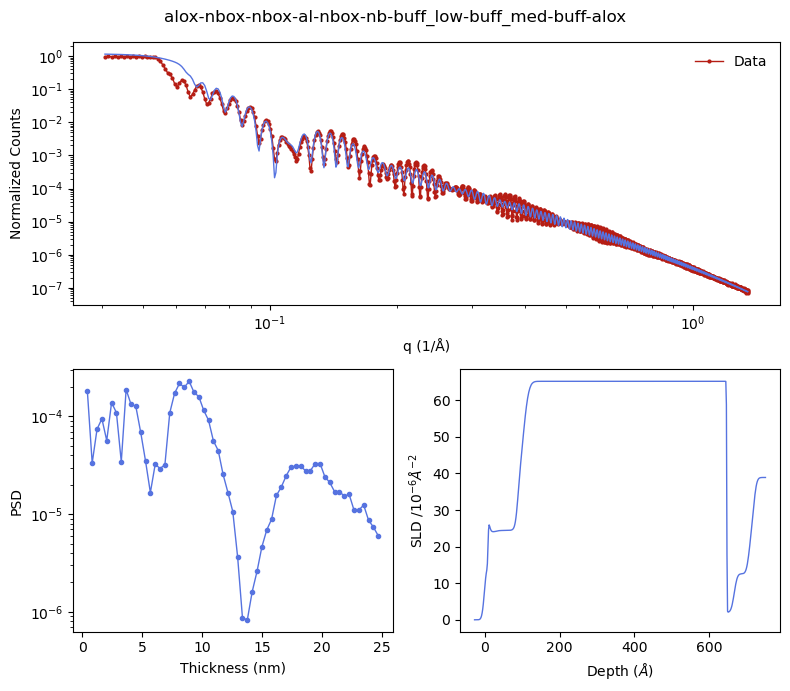

2.010029867097721: : 1133it [24:36,  1.30s/it] 


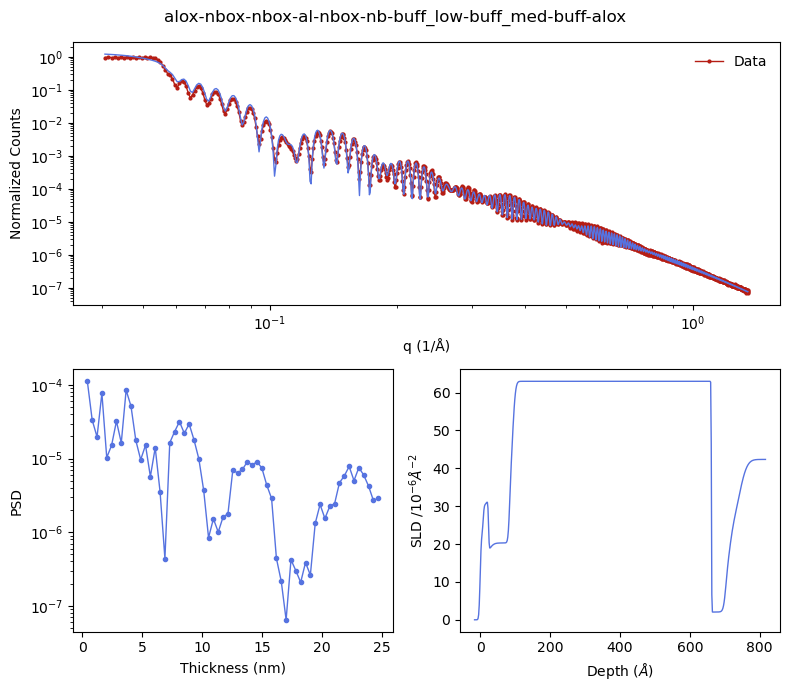

2.066242516725129: : 1220it [25:42,  1.26s/it] 


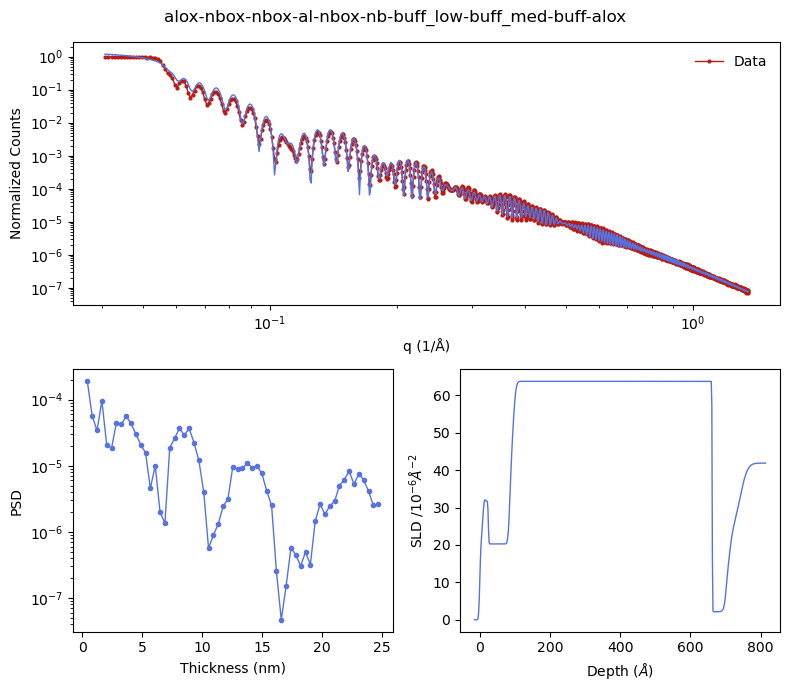

2.095639911882457: : 983it [20:26,  1.25s/it] 


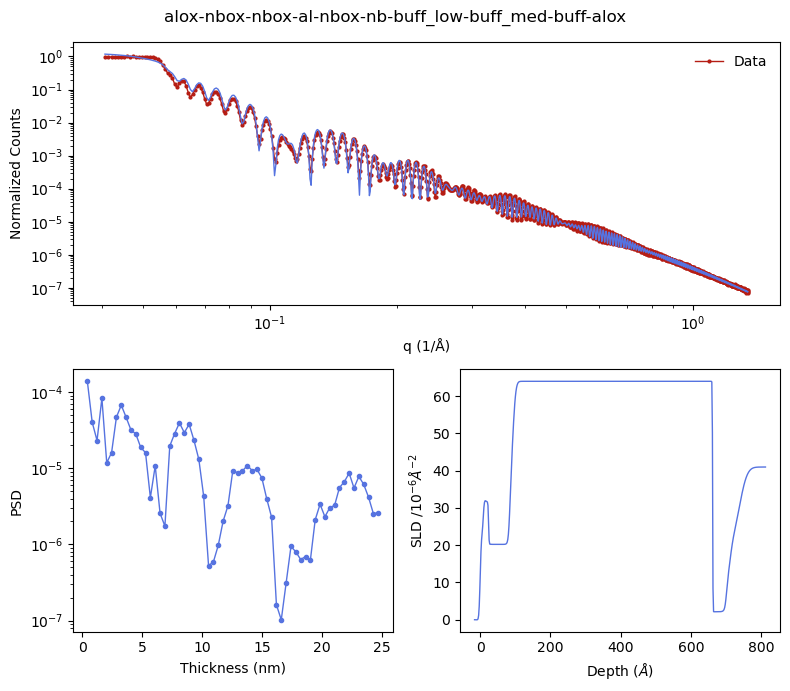

2.097629734294685: : 721it [14:02,  1.17s/it] 


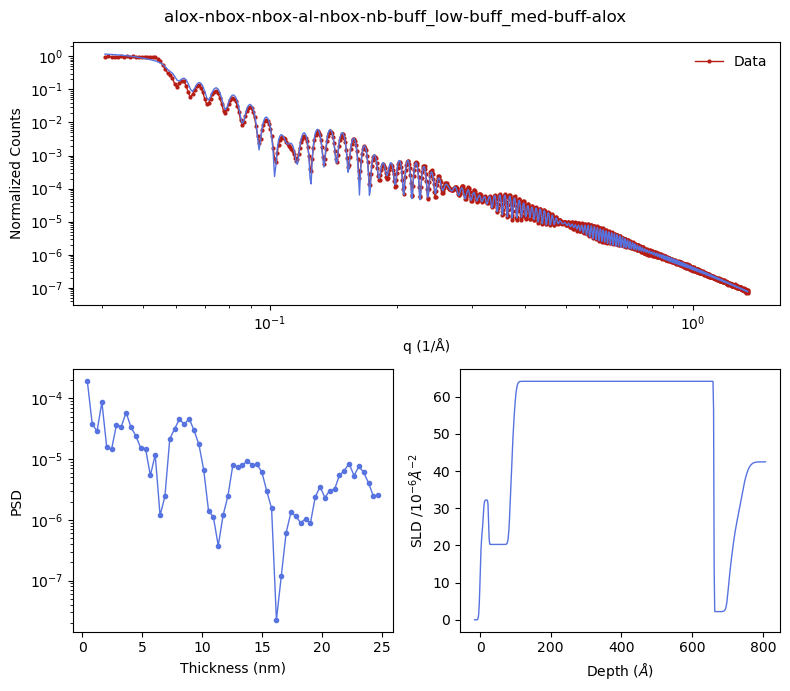

1.8604833595025527: : 1136it [21:20,  1.13s/it]


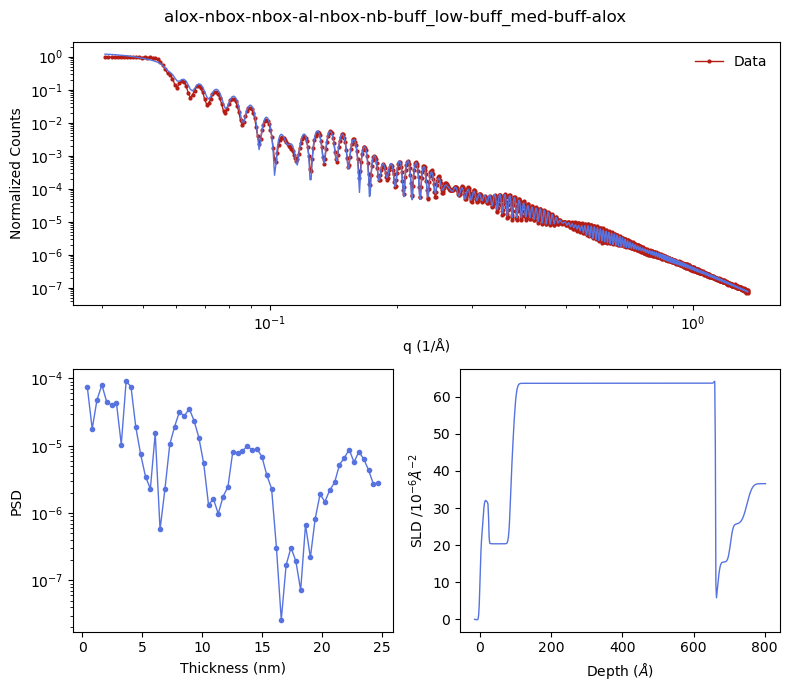

In [294]:
%matplotlib inline
qrng = [0.04, 0.15]

SLD_rng = [0.55, 0.1]
x_err = np.linspace(1.5,2.5, 6)
layer = 'alox/nbox/nbox/al/nbox/nb/buff_low/buff_med/buff/alox'
out_lists = [[] for _ in range(len(x_err))]

for i in range(6,5,-1): 
    qrng[1]=0.15 + 0.05*i+0.025*i**2
    for j in range(len(x_err)):
        par = {'scale':1, 'bkg':5e-9, 'q_offset':0, 'dq - resolution':0.5, 'sub_rough_max':20,'x_err':x_err[j]}
        par['thk']=[60, 570]
        out_lists[j].append(ana_xrr.sim(pth + flist[13], layer, par, qrng, SLD_rng=SLD_rng))

full_obj = ana_xrr.collect_obj(out_lists)
full_pars = ana_xrr.collect_pars(out_lists)

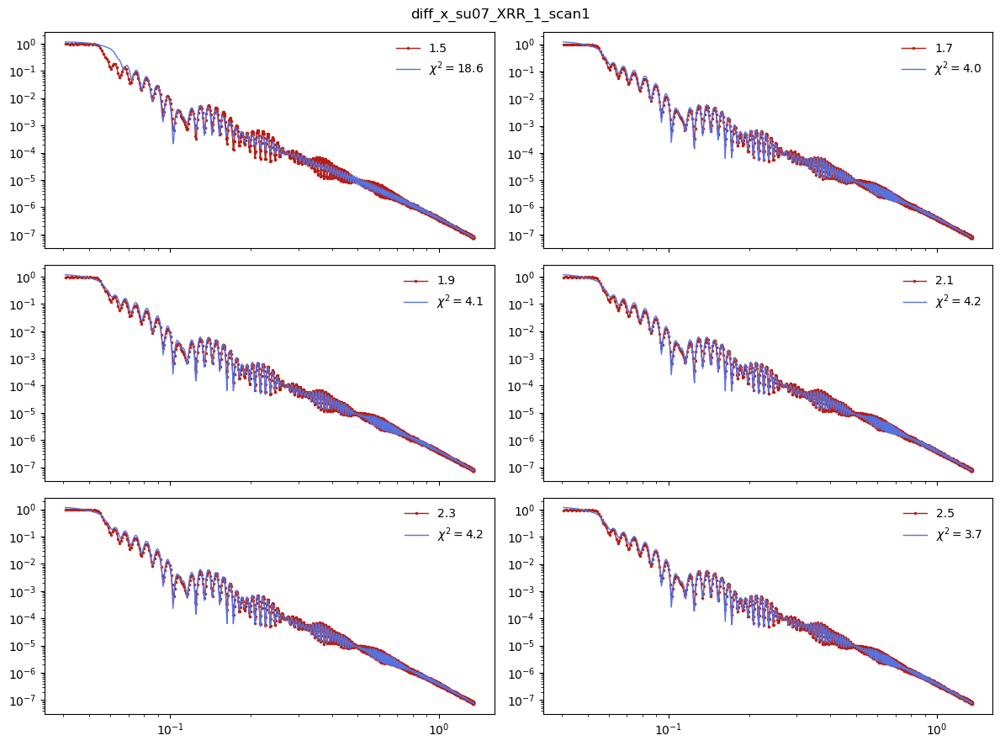

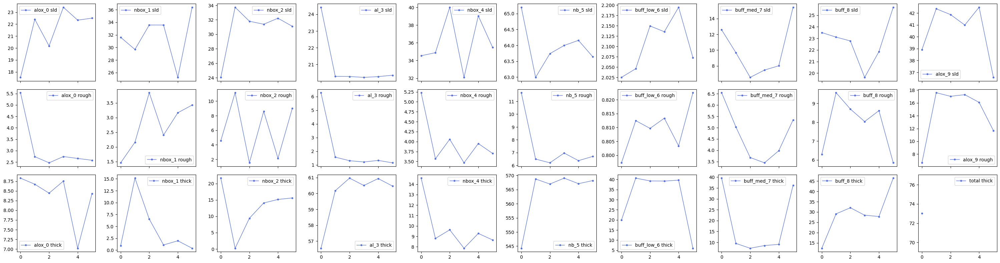

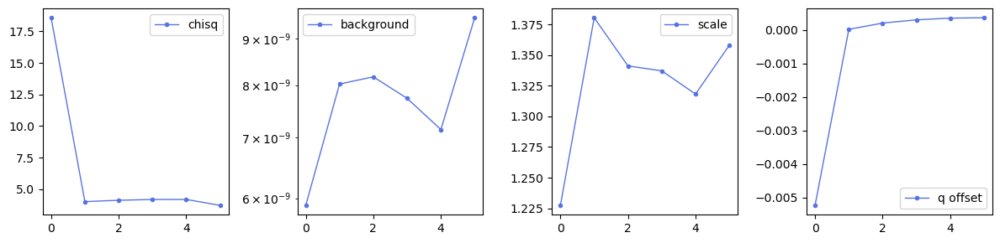

In [295]:

plot_ind = 0 
q_ind = 0
# outer is layers, inner is q range  
ana_xrr.plot_obj_pane(grab_ind(full_obj,q_ind), x_err, ind=plot_ind, path=img_pth, fname='diff_x_'+data_file[0:-4])
ana_xrr.compare_pars(grab_ind(full_pars,q_ind), img_path=img_pth, fname=layers[0].replace('/', '-')+'_'+data_file[0:-4])

In [ ]:

print(len(full_obj))
layer_ind = 2
ana_xrr.plot_obj_pane(full_obj[layer_ind], ['Data']*len(full_obj[layer_ind]), ind=len(full_obj[layer_ind])-1, path=img_pth, fname=layers[layer_ind].replace('/', '-')+'_'+data_file[0:-4])

ana_xrr.compare_pars(full_pars[layer_ind], img_path=img_pth, fname=layers[layer_ind].replace('/', '-')+'_'+data_file[0:-4])

In [ ]:
print(len(full_obj))
layer_ind = 2
ana_xrr.plot_obj_pane(full_obj[layer_ind], ['Data']*len(full_obj[layer_ind]), ind=len(full_obj[layer_ind])-1, path=img_pth, fname=layers[layer_ind].replace('/', '-')+'_'+data_file[0:-4])

ana_xrr.compare_pars(full_pars[layer_ind], img_path=img_pth, fname=layers[layer_ind].replace('/', '-')+'_'+data_file[0:-4])

In [281]:
full_obj = ana_xrr.collect_obj(out_lists)
full_pars = ana_xrr.collect_pars(out_lists)


In [20]:
full_obj = ana_xrr.collect_obj(out_lists)
def grab_ind(obj_list, ind): 
    return [o[ind] for o in obj_list]
sns.set_palette('coolwarm', 10)
plt.rcParams['lines.linewidth'] = 1
xlist = x_err 
# ind refers to what data is shown 
# first number is which data set 
ana_xrr.plot_obj_pane(grab_ind(full_obj,5), xlist, ind=0, path=img_pth, fname='test')

NameError: name 'x_err' is not defined

### Check chi square

Text(0.5, 0, 'Q range')

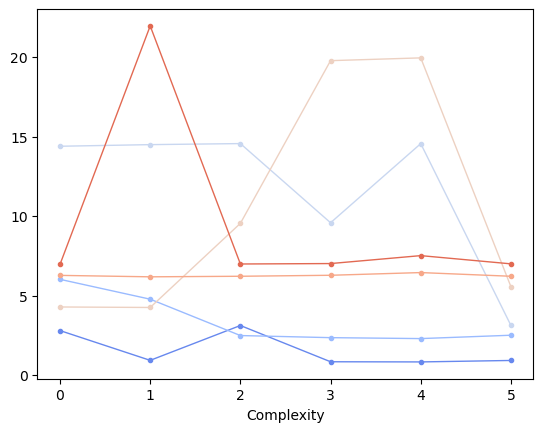

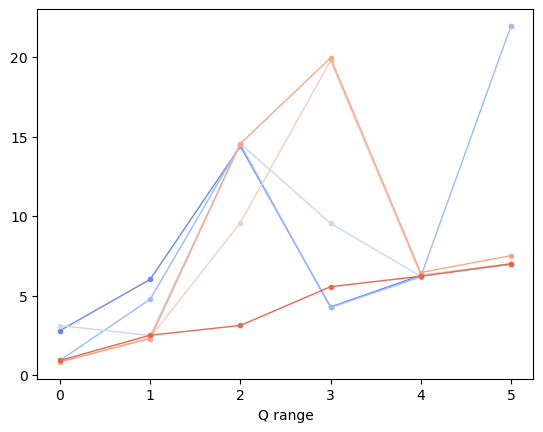

In [28]:
c = []; dq = []
for j in range(len(out_lists[0])):
    c.append([o[j][1]['chisq'].tolist() for o in out_lists[0:]])
    dq.append([o[j][1]['dq - resolution'] for o in out_lists[1:]])

sns.set_palette('coolwarm',6)
plotval = np.array(c)
plt.figure()
plt.plot(plotval.T,'.-')
plt.xlabel('Complexity')
sns.set_palette('coolwarm',6)
plt.figure()
plt.plot(plotval,'.-')
plt.xlabel('Q range')

0.08296912497649979: : 1000it [03:53,  4.29it/s]


Layer Properties:
  Layer  Thickness (nm)  Roughness (nm)  SLD (10^-6 cm^-2)
 alox_0       10.537592        0.974386          30.164540
   al_1       66.579193        0.767190          22.246699
 buff_2        5.986457        0.049618           4.547989
   nb_3      571.495964        7.866434          64.572737
 buff_4       14.292040        0.667140           7.127393
 alox_5       38.311807        7.518633          20.581301
al2o3_6             inf       11.340046          33.319000

Additional Parameters:
       Parameter               Value
           Chisq 0.16525539550481624
Log10 Background            -6.30103
 DQ - Resolution            1.563117
        Q Offset            0.001209
           Scale            1.453363


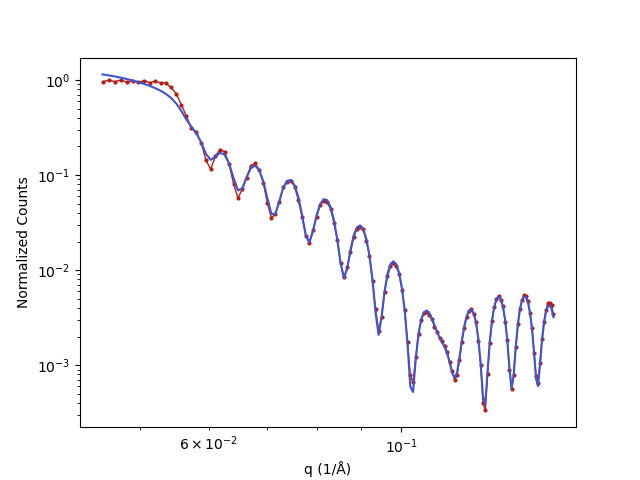

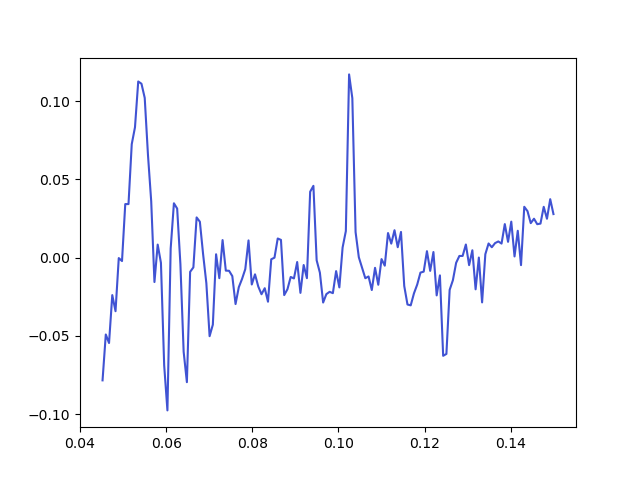

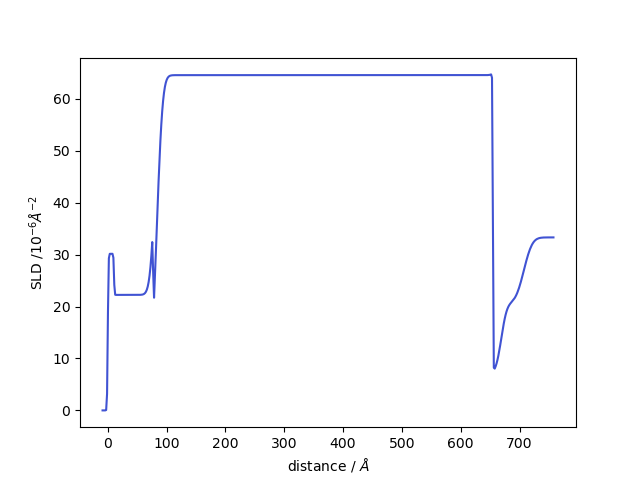

In [246]:
par2={'scale':1, 'bkg':5e-9, 'q_offset':0, 'dq - resolution':0.5, 'sub_rough_max':20, 
     'thk':[11, 45, 5.6, 576, 1,5, np.inf], 
     'rough':[3.7,1.6,5,7.3,1,1,3], 
     'sld':[28, 20, 11, 65, 11, 30,33.319]}
obj, par = ana_xrr.sim(pth + flist[13], 'alox/al/buff/nb/buff/alox/al2o3', par2, [0.045, 0.15], SLD_rng=[0.7,0.2], fit=True)
ana_xrr.generate_table(par)